# Подготовка данных

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

/home/tgorlenko/anaconda3/lib/python3.7/site-packages/pandas/compat/_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.8' currently installed).
  warnings.warn(msg, UserWarning)


Посмотрим на данные.

In [3]:
df = pd.read_csv('./data/survey_results_public.csv')
df.head(2).T

,0,1
ResponseId,1,2
MainBranch,I am a developer by profession,I am a student who is learning to code
Employment,"Independent contractor, freelancer, or self-em...","Student, full-time"
Country,Slovakia,Netherlands
US_State,NaN,NaN
UK_Country,NaN,NaN
EdLevel,"Secondary school (e.g. American high school, G...","Bachelor’s degree (B.A., B.S., B.Eng., etc.)"
Age1stCode,18 - 24 years,11 - 17 years
LearnCode,Coding Bootcamp;Other online resources (ex: vi...,"Other online resources (ex: videos, blogs, etc..."
YearsCode,NaN,7


In [4]:
df.shape[0]

83439

Наша основная цель -- предсказывать **ConvertedCompYearly**.

## Препроцессинг

Сначала, выбросим ненужное и то, что позволяет "заглянуть" в таргет.

In [5]:
df.dropna(subset=['ConvertedCompYearly'], inplace=True)
df.drop(['ResponseId', 'CompTotal', 'CompFreq'], axis=1, inplace=True)

In [6]:
df.shape[0]

46844

Также выбросим вещи, которые по каким-то причинам не нужны либо их нельзя использовать (например, из-за того, что в данных слишком много пропусков).

In [7]:
columns_to_drop = [
    'US_State', # most of this data is missing
    'UK_Country', # most of this data is missing
    
    # I have no idea if these can bring something useful...
    'Trans',
    'Sexuality',
    'Accessibility',
    'MentalHealth',
    
    # these features showed high correlation with
    # corresponding 'xxxHaveToWorkWith'
    'LanguageWantToWorkWith',
    'DatabaseWantToWorkWith',
    'PlatformWantToWorkWith',
    'WebframeWantToWorkWith',
    'MiscTechWantToWorkWith',
    'ToolsTechWantToWorkWith',
    'NEWCollabToolsWantToWorkWith'
]

df.drop(columns_to_drop, axis=1, inplace=True)

Для неокторых категориальных признаков есть очень много возможных категорий. Мы оставим top-5, остальное пойдет в категорию Other.

In [8]:
def leave_top_k(col, k=5):
    top_k = df[col].value_counts()[:k].keys()
    df[col] = df[col].mask(~df[col].isin(top_k), 'Other')

    
for col in ['Country', 'EdLevel', 'Age1stCode', 'OrgSize', 'Currency', 'Gender', 'Ethnicity']:
    leave_top_k(col)

Сделаем YearsCode и YearsCodePro числовыми

In [9]:
for col in ['YearsCode', 'YearsCodePro']:
    df[col] = df[col].mask(df[col] == 'Less than 1 year', 0)
    df[col] = df[col].mask(df[col] == 'More than 50 years', 50)
    # just drop observations that do not have info
    df = df[~df[col].isna()]
    # cast to int type

df = df.astype({ 'YearsCode': 'int32', 'YearsCodePro': 'int32'})

Проверим распределение зарплат.

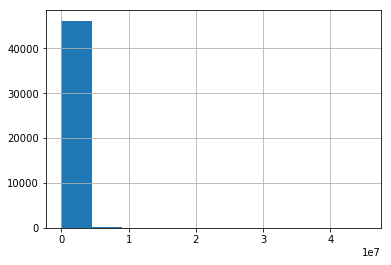

In [10]:
df['ConvertedCompYearly'].hist();

Отфильтруем выбросы

In [11]:
df = df[
    (df['ConvertedCompYearly'] > df['ConvertedCompYearly'].quantile(.05)) &
    (df['ConvertedCompYearly'] < df['ConvertedCompYearly'].quantile(.95))
]

Снова проверим распределение зарплат. Сейчас все должно быть хорошо.

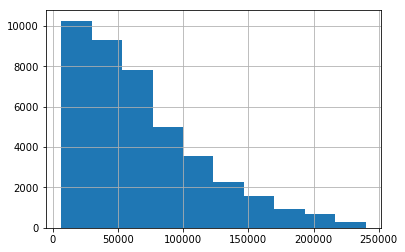

In [12]:
df['ConvertedCompYearly'].hist();

Сгенерируем признаки из текстовых данных. К примеру, если человек ответил

LanguageHaveWorkedWith -> JavaScript, HTML/CSS

то будут сгенерированы признаки

* LanguageHaveWorkedWith_JavaScript True
* LanguageHaveWorkedWith_HTML/CSS	True
* LanguageHaveWorkedWith_SQL False

In [13]:
from collections import Counter

def generate_features_from_multiple_choices(col, k=3):
    """
    k is a maximal number of features to be generated
    """
    cnt = Counter()
    for el in df[col]:
        for feature in str(el).split(';'):
            cnt[feature] += 1
    del cnt['nan']
    
    for feature in [el[0] for el in cnt.most_common(k)]:
        df[f'{col}_{feature}'] = df[col].apply(lambda text: feature in str(text))
    df.drop(col, axis=1, inplace=True)

        
for col in ['LearnCode',
            'DevType',
            'LanguageHaveWorkedWith',
            'DatabaseHaveWorkedWith',
            'PlatformHaveWorkedWith',
            'WebframeHaveWorkedWith',
            'MiscTechHaveWorkedWith',
            'ToolsTechHaveWorkedWith',
            'NEWCollabToolsHaveWorkedWith',
            'NEWStuck',
            'NEWSOSites'
           ]:
    generate_features_from_multiple_choices(col)

Посмотрим на то, что получилось!

In [14]:
df.shape

(41636, 54)

In [15]:
df.head(1).T

,9
MainBranch,I am a developer by profession
Employment,Employed full-time
Country,Other
EdLevel,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)"
Age1stCode,11 - 17 years
YearsCode,7
YearsCodePro,4
OrgSize,Other
Currency,Other
OpSys,Linux-based


Признаки Age и Age1stCode тоже сделаем числовыми

In [16]:
df = df[(df['Age'].notna()) & (df['Age'] != 'Under 18 years old') &
   (df['Age'] != 'Prefer not to say') & (df['Age'] != '65 years or older') & (df['Age1stCode'] != 'Other')]

look_up_age = {'25-34 years old': 29.5, '45-54 years old': 29.5, '35-44 years old': 39.5,
       '18-24 years old': 21, '55-64 years old': 59.5}
look_up_age_1st_code = {'11 - 17 years': 14, '5 - 10 years': 7.5, '25 - 34 years': 29.5, '18 - 24 years': 21,
       '35 - 44 years': 39.5}
age = df['Age'].apply(lambda v: look_up_age[v])
age_1st_code = df['Age1stCode'].apply(lambda v: look_up_age_1st_code[v])
df = df.drop(columns=['Age', 'Age1stCode'])
df['Age'] = age
df['Age1stCode'] = age_1st_code
df.head(1).T

,9
MainBranch,I am a developer by profession
Employment,Employed full-time
Country,Other
EdLevel,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)"
YearsCode,7
YearsCodePro,4
OrgSize,Other
Currency,Other
OpSys,Linux-based
SOVisitFreq,Multiple times per day


Заполним пропуски и сохраним данные

In [17]:
df = df.fillna('N/A')

In [18]:
df.to_csv('./data/processed/full_data.csv', index=False)

In [19]:
X = df.drop('ConvertedCompYearly', axis=1)
y = df['ConvertedCompYearly']

Разобьем нашу выборку на train, val и test: 

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

Сохраним в csv, чтобы в любой момент потом можно было восстановить:

In [21]:
X_train.to_csv('./data/processed/X_train.csv', index=False)
X_val.to_csv('./data/processed/X_val.csv', index=False)
X_test.to_csv('./data/processed/X_test.csv', index=False)

In [22]:
y_train.to_csv('./data/processed/y_train.csv', index=False)
y_val.to_csv('./data/processed/y_val.csv', index=False)
y_test.to_csv('./data/processed/y_test.csv', index=False)

Для некоторых алгоритмов будет нужен one hot encoding

In [23]:
def ohe(df: pd.DataFrame):
    X = df.drop('ConvertedCompYearly', axis=1)
    y = df['ConvertedCompYearly']
    
    cat_cols = X.select_dtypes(include=['object']).columns
    for col in  cat_cols:
        X = pd.concat([X.drop(col, axis=1),
                       pd.get_dummies(X[col], prefix=col, prefix_sep='_', drop_first=True)],
                       axis=1)
    
    return X, y
    
X_ohe, y_ohe = ohe(df)

# Поиск причинно-следственных связей

Импортируем нужные библиотеки

In [24]:
import numpy as np
import pandas as pd

import dowhy
from dowhy import CausalModel
import pygraphviz


# these non-covergence warnings are very annoyning, we'll disable them
import warnings
from sklearn.exceptions import DataConversionWarning, ConvergenceWarning
warnings.filterwarnings(action='ignore', category=DataConversionWarning)
warnings.filterwarnings(action='ignore', category=ConvergenceWarning)
warnings.filterwarnings(action='ignore', category=UserWarning)
warnings.filterwarnings(action='ignore', category=FutureWarning)

In [25]:
# dataset = pd.read_csv('./data/processed/full_data.csv')
dataset = df.copy()

### Препроцессинг

Здесь сделаем небольшой препроцессинг, специфический для поиска причинно-следственных связей. В частности, treatment может быть только бинарным, поэтому в основном весь препроцессинг состоит в том, чтобы преобразовать небинарный категориальный признак в бинарный (при этом теряя некоторую информацию об остальных категориях).

Задачи которые мы хотим посмотреть:

* ~~влияет ли пол на заработную плату~~,
* ~~влияет ли трудоустройство на полную ставку на зарплату~~,
* интересно, как влияет на зарплату то, что человек часто посещает StackOverflow,
* если есть степень (Ph.D.), повышает ли это шансы на более высокую зарплату?

Сначала переделаем нашу задачу в задачу классификации. Пакету DoWhy не очень нравится делать оценки для регрессии :( По крайней мере это сложнее, кроме того разброс в оцениваемых эффектах был в разы больше.

Будем считать зарплату высокой, если она больше медианной.

In [25]:
dataset['high_salary'] = dataset['ConvertedCompYearly'] > dataset['ConvertedCompYearly'].median()
dataset.drop('ConvertedCompYearly', axis=1, inplace=True)

In [26]:
dataset['frequent_visit_SO'] = dataset['SOVisitFreq'] == 'Multiple times per day'
dataset.drop('SOVisitFreq', axis=1, inplace=True)

dataset['has_phd'] = dataset['EdLevel'] == 'Other doctoral degree (Ph.D., Ed.D., etc.)'

Проверим, что все ок после нашего препроцессинга

In [27]:
assert dataset['frequent_visit_SO'].sum() != 0
assert dataset['has_phd'].sum() != 0

### Модель 1. Custom causal graph

Опишем как на наш взгляд связаны признаки в данных. Для этого зададим следующий causal graph (тут взяты не все признаки, поскольку признаков очень много и граф был бы необозримым).

In [28]:
# Setting a causal graph
causal_graph = """digraph {
U[label="Unobserved Confounders"];
high_salary;
has_phd;
MainBranch;
Employment;
Country;
Ethnicity;
EdLevel;
YearsCode;
YearsCodePro;
OrgSize;
Currency;
OpSys;
Gender;
Age;
Age1stCode;
YearsCode->YearsCodePro;
Country->Currency;
EdLevel->high_salary;
YearsCode->high_salary;
Employment->YearsCode;
YearsCode->frequent_visit_SO;
YearsCodePro->frequent_visit_SO;
YearsCode->OpSys;
YearsCodePro->OpSys;
Country->Ethnicity;
Country->high_salary;
OrgSize->high_salary;
MainBranch->frequent_visit_SO;
YearsCodePro->high_salary;
Age1stCode->YearsCode;
Age->YearsCode;
Gender->MainBranch;
has_phd->EdLevel;
has_phd->Age;
frequent_visit_SO->high_salary;
Ethnicity->high_salary;
Currency->high_salary;
U->Age1stCode; U->YearsCode; U->Employment;U->high_salary;U->MainBranch;U->has_phd;U->OrgSize;
}"""

Посмотрим, как влияет на заработную плату наличие докторской/кандидатской степени у человека. Для этого в treatment укажем has_phd, а в outcome -- high_salary.

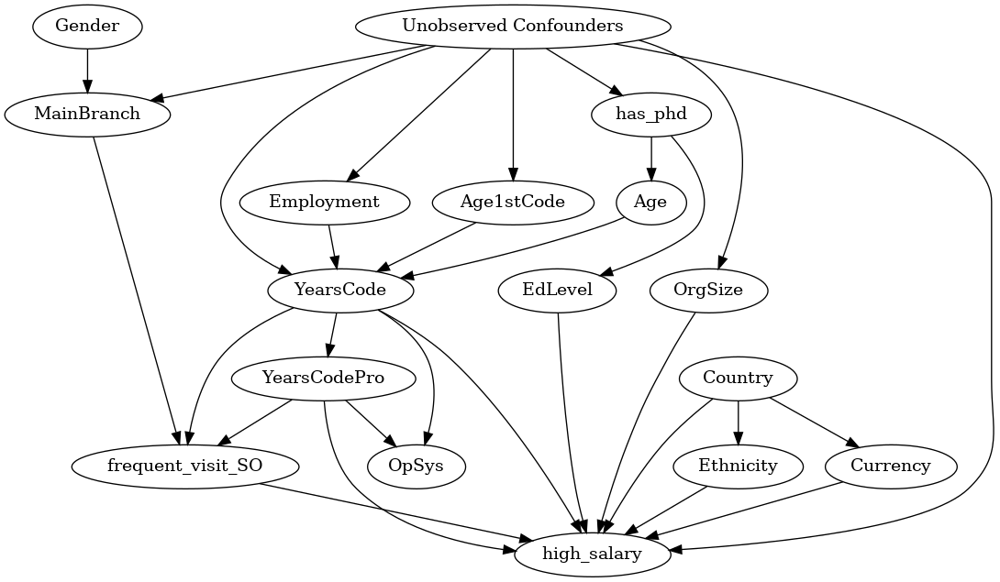

In [29]:
model=CausalModel(
        data=dataset,
        graph=causal_graph.replace('\n', ' '),
        treatment='has_phd',
        outcome='high_salary')

model.view_model()

from IPython.display import Image, display
display(Image(filename="causal_model.png"))

Предположения, которые были сделаны:

* Если есть Ph.D, то возраст у опрашиваемого будет вероятно не меньше 27, то есть has_phd влияет на возраст. Также, наличие степени однозачно определяет EdLevel
* Age1stCode и Age могут определять YearsCode
* YearsCode в свою очередь часто будет совпадать или быть чуть больше чем YearsCodePro
* Неочевидное (и возможно неверное) предположение: число лет опыта влияет на выбор операционной системы (например, популярный тренд для опытных разработчиков --  переходить на MacOS)
* Страна сильно влияет на зарплату, поскольку везде разный уровень жизни

In [30]:
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
print(identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
    d                                                                                                          
──────────(Expectation(high_salary|OrgSize,Country,Gender,Employment,Age1stCode,MainBranch,Ethnicity,Currency))
d[has_phd]                                                                                                     
Estimand assumption 1, Unconfoundedness: If U→{has_phd} and U→high_salary then P(high_salary|has_phd,OrgSize,Country,Gender,Employment,Age1stCode,MainBranch,Ethnicity,Currency,U) = P(high_salary|has_phd,OrgSize,Country,Gender,Employment,Age1stCode,MainBranch,Ethnicity,Currency)

### Estimand : 2
Estimand name: iv
No such variable found!

### Estimand : 3
Estimand name: frontdoor
No such variable found!



In [31]:
estimate = model.estimate_effect(identified_estimand,
                                 method_name="backdoor.propensity_score_stratification",
                                 target_units="ate")
print(estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
    d                                                                                                          
──────────(Expectation(high_salary|OrgSize,Country,Gender,Employment,Age1stCode,MainBranch,Ethnicity,Currency))
d[has_phd]                                                                                                     
Estimand assumption 1, Unconfoundedness: If U→{has_phd} and U→high_salary then P(high_salary|has_phd,OrgSize,Country,Gender,Employment,Age1stCode,MainBranch,Ethnicity,Currency,U) = P(high_salary|has_phd,OrgSize,Country,Gender,Employment,Age1stCode,MainBranch,Ethnicity,Currency)

## Realized estimand
b: high_salary~has_phd+OrgSize+Country+Gender+Employment+Age1stCode+MainBranch+Ethnicity+Currency
Target units: ate

## Estimate
Mean value: 0.15249050329162264



Попробуем random_common_cause. Видим, что оцениваемый эффект практически не поменялся. Это хорошо!

In [32]:
# Adds randomly drawn covariates to data and re-runs the analysis to see if the causal estimate changes or not.
# If our assumption was originally correct then the causal estimate shouldn’t change by much.
refute1_results=model.refute_estimate(identified_estimand, estimate,
        method_name="random_common_cause")
print(refute1_results)

Refute: Add a Random Common Cause
Estimated effect:0.15249050329162264
New effect:0.15901095932888165



Следующим попробуем placebo treatment. Полученный новый эффект должен быть в районе нуля. Так и есть.

In [33]:
# Randomly assigns any covariate as a treatment and re-runs the analysis. If our 
# assumptions were correct then this newly found out estimate should go to 0.
refute2_results=model.refute_estimate(identified_estimand, estimate,
        method_name="placebo_treatment_refuter", placebo_type="permute")
print(refute2_results)

Refute: Use a Placebo Treatment
Estimated effect:0.15249050329162264
New effect:0.0016712462789786938
p value:0.46



Наконец, попробуем data_subset_refuter. Новый эффект не должен сильно отличаться от старого.

In [34]:
#Creates subsets of the data(similar to cross-validation) and checks whether the 
# causal estimates vary across subsets. If our assumptions were correct there shouldn’t be much variation.
res_subset=model.refute_estimate(identified_estimand, estimate,
        method_name="data_subset_refuter", subset_fraction=0.9)
print(res_subset)

Refute: Use a subset of data
Estimated effect:0.15249050329162264
New effect:0.15217793382215805
p value:0.5



Таким образом, мы можем с определенной долей уверенности утверждать, что наличие степени не очень сильно, но положительно влияет на зарплату, поскольку мы имеем подтверждение от всех трех refuter'ов.

Объяснить этот факт можно просто: специалисты со степенью чуть более квалифицированны. Ну или степень добавляет плюсик в резюме :)

Впрочем, если бы получился противоположный результат, тоже нашлась бы интерпретация: пока один человек получает степень, второй получает опыт в индустрии, а имея больше опыта, логично, что зарабатывает больше.

Теперь то же самое сделаем для частых визитов на StackOverflow

In [36]:
model=CausalModel(
        data=dataset,
        graph=causal_graph.replace('\n', ' '),
        treatment='frequent_visit_SO',
        outcome='high_salary')

identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
print(identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
         d                                                                                                            
────────────────────(Expectation(high_salary|OrgSize,Country,has_phd,OpSys,Gender,Employment,Age1stCode,MainBranch,Age
d[frequent_visit_SO]                                                                                                  

                                                    
,YearsCodePro,Ethnicity,EdLevel,YearsCode,Currency))
                                                    
Estimand assumption 1, Unconfoundedness: If U→{frequent_visit_SO} and U→high_salary then P(high_salary|frequent_visit_SO,OrgSize,Country,has_phd,OpSys,Gender,Employment,Age1stCode,MainBranch,Age,YearsCodePro,Ethnicity,EdLevel,YearsCode,Currency,U) = P(high_salary|frequent_visit_SO,OrgSize,Country,has_phd,OpSys,Gender,Employment,Age1stCode,MainBranch,Age,YearsCodePro,Ethnicity,EdLevel,

In [37]:
estimate = model.estimate_effect(identified_estimand,
                                 method_name="backdoor.propensity_score_stratification",
                                 target_units="ate")
print(estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
         d                                                                                                            
────────────────────(Expectation(high_salary|OrgSize,Country,has_phd,OpSys,Gender,Employment,Age1stCode,MainBranch,Age
d[frequent_visit_SO]                                                                                                  

                                                    
,YearsCodePro,Ethnicity,EdLevel,YearsCode,Currency))
                                                    
Estimand assumption 1, Unconfoundedness: If U→{frequent_visit_SO} and U→high_salary then P(high_salary|frequent_visit_SO,OrgSize,Country,has_phd,OpSys,Gender,Employment,Age1stCode,MainBranch,Age,YearsCodePro,Ethnicity,EdLevel,YearsCode,Currency,U) = P(high_salary|frequent_visit_SO,OrgSize,Country,has_phd,OpSys,Gender,Employment,Age1stCod

Видим, что получилась очень маленькая оценка. Попробуем random cause

In [38]:
# Adds randomly drawn covariates to data and re-runs the analysis to see if the causal estimate changes or not.
# If our assumption was originally correct then the causal estimate shouldn’t change by much.
refute1_results=model.refute_estimate(identified_estimand, estimate,
        method_name="random_common_cause")
print(refute1_results)

Refute: Add a Random Common Cause
Estimated effect:-0.02555611552317933
New effect:-0.022363633871497517



То, что эффект не сильно поменялся, на самом деле здесь ничего не значит, поскольку величина этого эффекта очень мала. Интересно посмотреть на placebo_treatment

In [39]:
# Randomly assigns any covariate as a treatment and re-runs the analysis. If our 
# assumptions were correct then this newly found out estimate should go to 0.
refute2_results=model.refute_estimate(identified_estimand, estimate,
        method_name="placebo_treatment_refuter", placebo_type="permute")
print(refute2_results)

Refute: Use a Placebo Treatment
Estimated effect:-0.02555611552317933
New effect:-0.00012193930272914263
p value:0.48



Наконец, глянем еще раз на data_subset_refuter

In [40]:
#Creates subsets of the data(similar to cross-validation) and checks whether the 
# causal estimates vary across subsets. If our assumptions were correct there shouldn’t be much variation.
res_subset=model.refute_estimate(identified_estimand, estimate,
        method_name="data_subset_refuter", subset_fraction=0.9)
print(res_subset)

Refute: Use a subset of data
Estimated effect:-0.02555611552317933
New effect:-0.024651476127951016
p value:0.32



Получается, что и здесь все три refuter'а подтвердили, что частые заходы на StackOverflow могут свидетельствовать о более низкой зарплате.

Это можно объяснить так: неопытные разработчики заходят на StackOverflow на каждый чих, в то время как опытные пользуются более избирательно.

Но здесь стоит опять оговориться, что доверия к этим результатам меньше, поскольку величина эффекта очень мала.

### Модель 2. Граф по умолчанию.

Попробуем теперь граф по умолчанию. Поскольку признаков очень много, граф получается необозримым.

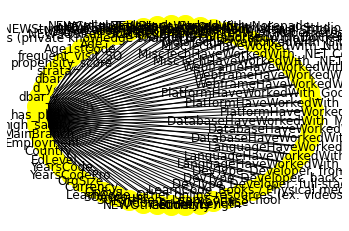

In [45]:
common_causes = [el for el in list(dataset.columns)
                 if el != 'ConvertedCompYearly' and el != 'high_salary' and el != 'has_phd'] + ['']

model=CausalModel(
        data = dataset,
        treatment='has_phd',
        outcome='high_salary',
        common_causes=common_causes)

model.view_model()

Укажем, что мы хотим оценить

In [46]:
#Identify the causal effect
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
print(identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
    d                                                                                                                 
──────────(Expectation(high_salary|OrgSize,Country,OpSys,SOComm,NEWOtherComms,ToolsTechHaveWorkedWith_Kubernetes,Ethni
d[has_phd]                                                                                                            

                                                                                                                      
city,LearnCode_Other online resources (ex: videos, blogs, etc),WebframeHaveWorkedWith_Angular,ToolsTechHaveWorkedWith_
                                                                                                                      

                                                                                                                      
Docker,NEWSOSites_Stack Overflow,dbar,WebframeHaveWorkedWith_React.js

Сделаем саму оценку

In [47]:
estimate = model.estimate_effect(identified_estimand,
                                 method_name="backdoor.propensity_score_stratification",
                                 target_units="ate")
print(estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
    d                                                                                                                 
──────────(Expectation(high_salary|OrgSize,Country,OpSys,SOComm,NEWOtherComms,ToolsTechHaveWorkedWith_Kubernetes,Ethni
d[has_phd]                                                                                                            

                                                                                                                      
city,LearnCode_Other online resources (ex: videos, blogs, etc),WebframeHaveWorkedWith_Angular,ToolsTechHaveWorkedWith_
                                                                                                                      

                                                                                                                      
Docker,NEWSOSites_Sta

Видим, что в полном графе наличие степени отрицательно сказывается на заработной плате, хоть и куда слабее.

Наконец, сделаем refutation, чтобы понять насколько были верны наши предположения. Сначала попробуем random_cause. Видим, что что случайный шум может исказить значимость -- новый эффект получился другим.

In [51]:
# Adds randomly drawn covariates to data and re-runs the analysis to see if the causal estimate changes or not.
# If our assumption was originally correct then the causal estimate shouldn’t change by much.
refute1_results=model.refute_estimate(identified_estimand, estimate,
        method_name="random_common_cause")
print(refute1_results)

Refute: Add a Random Common Cause
Estimated effect:-0.10099715409180775
New effect:0.05397811619705561



In [49]:
# Randomly assigns any covariate as a treatment and re-runs the analysis. If our 
# assumptions were correct then this newly found out estimate should go to 0.
refute2_results=model.refute_estimate(identified_estimand, estimate,
                                      method_name="placebo_treatment_refuter", placebo_type="permute")
print(refute1_results)

Refute: Add a Random Common Cause
Estimated effect:-0.10099715409180775
New effect:0.061885830563460864



Интересная ситуация: полученное p-value иногда показывает, что у нас достаточно уверенности в том, что наличие степени влияет на зарплату. Вывод, который можно сделать для себя -- надо проверять несколько refuter'ов, нельзя полагаться на один!

In [50]:
#Creates subsets of the data(similar to cross-validation) and checks whether the 
# causal estimates vary across subsets. If our assumptions were correct there shouldn’t be much variation.
res_subset=model.refute_estimate(identified_estimand, estimate,
        method_name="data_subset_refuter", subset_fraction=0.9)
print(res_subset)

Refute: Use a subset of data
Estimated effect:-0.10099715409180775
New effect:0.06755486133418404
p value:0.0



Таким образом, мы видим, что на дефолтном графе никакого влияния обнаружено не было (по крайней мере, оно не было подтверждено), в то время как на нашем кастомном графе было небольшое положительное влияние. Чему верить -- непонятно, но хочется именно кастомному графу, поскольку мы заложили туда знание о предметной области (хоть и не факт, что правильное).

# Обучение моделей черного ящика.

In [2]:
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error
from catboost import CatBoostRegressor

### Линейные модели

In [3]:
import pandas as pd
import numpy as np
from sklearn.linear_model import Ridge, Lasso, LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
from xgboost import XGBClassifier, XGBRegressor
from sklearn.ensemble import RandomForestRegressor

/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:30: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  method='lar', copy_X=True, eps=np.finfo(np.float).eps,
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:167: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  meth

In [4]:
X_train = pd.read_csv('./data/processed/X_train_ohe.csv', na_filter=False)
X_val = pd.read_csv('./data/processed/X_val_ohe.csv', na_filter=False)
X_test = pd.read_csv('./data/processed/X_test_ohe.csv', na_filter=False)

y_train = pd.read_csv('./data/processed/y_train_ohe.csv', na_filter=False)
y_val = pd.read_csv('./data/processed/y_val_ohe.csv', na_filter=False)
y_test = pd.read_csv('./data/processed/y_test_ohe.csv', na_filter=False)

In [5]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaler = scaler.transform(X_train)
X_val_scaler = scaler.transform(X_val)
X_test_scaler = scaler.transform(X_test)

#### L1 регуляризация

In [6]:
lasso_model = Lasso()
lasso_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(lasso_model.predict(X_val_scaler), y_val))

22829.418863135536


/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3516941950407.9707, tolerance: 5971007215.535019
  positive)


Настроим параметр регуляризации

In [7]:
lasso_model = Lasso(alpha=77)
lasso_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(lasso_model.predict(X_val_scaler), y_val))

22817.474633029353


In [8]:
print('Качество на тесте: ', mean_absolute_error(lasso_model.predict(X_test_scaler), y_test))

Качество на тесте:  22685.995494193452


#### L2 регуляризация

In [33]:
ridge_model = Ridge()
ridge_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(ridge_model.predict(X_val_scaler), y_val))

22830.846491116776


Настроим параметр регуляризации

In [34]:
ridge_model = Ridge(alpha=8)
ridge_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(ridge_model.predict(X_val_scaler), y_val))

22829.358576611365


In [35]:
print('Качество на тесте: ', mean_absolute_error(ridge_model.predict(X_test_scaler), y_test))

Качество на тесте:  22682.347082970748


#### ElasticNet

In [36]:
e_model = ElasticNet()
e_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(e_model.predict(X_val_scaler), y_val))

23644.867012977353


Настроим параметр регуляризации

In [37]:
e_model = ElasticNet(alpha=0.001, l1_ratio=0.7)
e_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(e_model.predict(X_val_scaler), y_val))

22829.421455370433


In [38]:
print('Качество на тесте: ', mean_absolute_error(e_model.predict(X_test_scaler), y_test))

Качество на тесте:  22682.47170120155


**ВЫВОД:** Из линейных моделей лучший результат показала регрессия с L2 регуляризацией, но модель L1 незначительно ей уступила, но зато признаков меньше. Поэтому дальнейший анализ будем проводить для модели Lasso.

## Ансамбль деревьев

### Catboost

In [39]:
X_train = pd.read_csv('./data/processed/X_train.csv', na_filter=False)
X_val = pd.read_csv('./data/processed/X_val.csv', na_filter=False)
X_test = pd.read_csv('./data/processed/X_test.csv', na_filter=False)

y_train = pd.read_csv('./data/processed/y_train.csv', na_filter=False)
y_val = pd.read_csv('./data/processed/y_val.csv', na_filter=False)
y_test = pd.read_csv('./data/processed/y_test.csv', na_filter=False)

In [40]:
cat_features = ['MainBranch', 'Employment', 'Country', 'EdLevel', 'OrgSize', 'Currency',
                'OpSys', 'SOVisitFreq', 'SOAccount', 'SOPartFreq', 'SOComm', 'NEWOtherComms',
                'Gender', 'Ethnicity', 'SurveyLength', 'SurveyEase']

model = CatBoostRegressor(loss_function='MAE', iterations=2000)
model.fit(X_train, y_train, cat_features=cat_features, eval_set=(X_val, y_val))

0:	learn: 36349.5968249	test: 36177.7377818	best: 36177.7377818 (0)	total: 99.6ms	remaining: 3m 19s
1:	learn: 35781.1758239	test: 35609.4010718	best: 35609.4010718 (1)	total: 118ms	remaining: 1m 58s
2:	learn: 35229.5389368	test: 35058.3565461	best: 35058.3565461 (2)	total: 137ms	remaining: 1m 31s
3:	learn: 34706.9492711	test: 34535.9542670	best: 34535.9542670 (3)	total: 156ms	remaining: 1m 17s
4:	learn: 34198.4659401	test: 34032.5800815	best: 34032.5800815 (4)	total: 177ms	remaining: 1m 10s
5:	learn: 33704.8323093	test: 33546.1418880	best: 33546.1418880 (5)	total: 197ms	remaining: 1m 5s
6:	learn: 33223.6869169	test: 33066.7699597	best: 33066.7699597 (6)	total: 221ms	remaining: 1m 2s
7:	learn: 32768.0137442	test: 32620.0579884	best: 32620.0579884 (7)	total: 252ms	remaining: 1m 2s
8:	learn: 32333.5171409	test: 32186.9408326	best: 32186.9408326 (8)	total: 278ms	remaining: 1m 1s
9:	learn: 31907.1656332	test: 31761.2303999	best: 31761.2303999 (9)	total: 308ms	remaining: 1m 1s
10:	learn: 315

84:	learn: 22463.9495214	test: 22604.4737287	best: 22604.4737287 (84)	total: 1.99s	remaining: 44.8s
85:	learn: 22439.4491326	test: 22582.9670298	best: 22582.9670298 (85)	total: 2.02s	remaining: 44.9s
86:	learn: 22414.7695487	test: 22563.8301730	best: 22563.8301730 (86)	total: 2.04s	remaining: 44.9s
87:	learn: 22388.2357518	test: 22541.2168280	best: 22541.2168280 (87)	total: 2.06s	remaining: 44.9s
88:	learn: 22367.1316623	test: 22522.1750836	best: 22522.1750836 (88)	total: 2.08s	remaining: 44.7s
89:	learn: 22348.5167397	test: 22505.6291894	best: 22505.6291894 (89)	total: 2.1s	remaining: 44.6s
90:	learn: 22321.9976190	test: 22480.9420263	best: 22480.9420263 (90)	total: 2.12s	remaining: 44.6s
91:	learn: 22300.3574837	test: 22461.2116754	best: 22461.2116754 (91)	total: 2.14s	remaining: 44.5s
92:	learn: 22276.4171866	test: 22439.8114750	best: 22439.8114750 (92)	total: 2.17s	remaining: 44.4s
93:	learn: 22255.2702223	test: 22420.3143202	best: 22420.3143202 (93)	total: 2.19s	remaining: 44.3s
9

167:	learn: 21381.9294217	test: 21710.6193332	best: 21710.6193332 (167)	total: 3.98s	remaining: 43.4s
168:	learn: 21375.8502454	test: 21704.3553700	best: 21704.3553700 (168)	total: 4.01s	remaining: 43.5s
169:	learn: 21368.4916246	test: 21699.0793449	best: 21699.0793449 (169)	total: 4.03s	remaining: 43.4s
170:	learn: 21359.9423178	test: 21695.0825826	best: 21695.0825826 (170)	total: 4.06s	remaining: 43.4s
171:	learn: 21355.1608647	test: 21692.9656586	best: 21692.9656586 (171)	total: 4.08s	remaining: 43.3s
172:	learn: 21349.6395952	test: 21688.6082680	best: 21688.6082680 (172)	total: 4.1s	remaining: 43.3s
173:	learn: 21342.7644130	test: 21684.4800666	best: 21684.4800666 (173)	total: 4.12s	remaining: 43.3s
174:	learn: 21336.2778831	test: 21678.8682278	best: 21678.8682278 (174)	total: 4.14s	remaining: 43.2s
175:	learn: 21332.3352328	test: 21676.2990751	best: 21676.2990751 (175)	total: 4.16s	remaining: 43.1s
176:	learn: 21327.1312852	test: 21671.8070945	best: 21671.8070945 (176)	total: 4.19

255:	learn: 20997.5674823	test: 21460.4613869	best: 21460.4613869 (255)	total: 5.9s	remaining: 40.2s
256:	learn: 20995.2633179	test: 21459.0806926	best: 21459.0806926 (256)	total: 5.92s	remaining: 40.2s
257:	learn: 20991.7975965	test: 21458.1840098	best: 21458.1840098 (257)	total: 5.95s	remaining: 40.2s
258:	learn: 20990.2669042	test: 21456.5703170	best: 21456.5703170 (258)	total: 5.97s	remaining: 40.2s
259:	learn: 20987.7510168	test: 21455.5536926	best: 21455.5536926 (259)	total: 6s	remaining: 40.1s
260:	learn: 20985.8570079	test: 21454.4902535	best: 21454.4902535 (260)	total: 6.02s	remaining: 40.1s
261:	learn: 20980.2154281	test: 21450.8560975	best: 21450.8560975 (261)	total: 6.04s	remaining: 40.1s
262:	learn: 20977.3883663	test: 21449.2288116	best: 21449.2288116 (262)	total: 6.06s	remaining: 40s
263:	learn: 20974.4197806	test: 21445.8202061	best: 21445.8202061 (263)	total: 6.07s	remaining: 39.9s
264:	learn: 20971.7821865	test: 21443.8748878	best: 21443.8748878 (264)	total: 6.09s	rem

341:	learn: 20712.7732683	test: 21290.0524843	best: 21290.0524843 (341)	total: 7.81s	remaining: 37.9s
342:	learn: 20708.7294177	test: 21286.3498799	best: 21286.3498799 (342)	total: 7.83s	remaining: 37.8s
343:	learn: 20703.0766678	test: 21282.2054898	best: 21282.2054898 (343)	total: 7.86s	remaining: 37.8s
344:	learn: 20698.3921727	test: 21280.7765389	best: 21280.7765389 (344)	total: 7.88s	remaining: 37.8s
345:	learn: 20694.5806233	test: 21279.2392102	best: 21279.2392102 (345)	total: 7.91s	remaining: 37.8s
346:	learn: 20693.0372166	test: 21278.5599630	best: 21278.5599630 (346)	total: 7.92s	remaining: 37.7s
347:	learn: 20690.0947946	test: 21277.1153456	best: 21277.1153456 (347)	total: 7.95s	remaining: 37.7s
348:	learn: 20687.4332295	test: 21276.3259071	best: 21276.3259071 (348)	total: 7.97s	remaining: 37.7s
349:	learn: 20687.0735226	test: 21276.1658479	best: 21276.1658479 (349)	total: 7.99s	remaining: 37.7s
350:	learn: 20685.0321052	test: 21274.9509112	best: 21274.9509112 (350)	total: 8.0

422:	learn: 20468.6096763	test: 21182.8411099	best: 21182.8411099 (422)	total: 9.71s	remaining: 36.2s
423:	learn: 20466.6560194	test: 21181.6064612	best: 21181.6064612 (423)	total: 9.73s	remaining: 36.2s
424:	learn: 20464.4093586	test: 21181.4651099	best: 21181.4651099 (424)	total: 9.76s	remaining: 36.2s
425:	learn: 20462.6760070	test: 21181.5170260	best: 21181.4651099 (424)	total: 9.78s	remaining: 36.1s
426:	learn: 20459.8952068	test: 21179.7357675	best: 21179.7357675 (426)	total: 9.8s	remaining: 36.1s
427:	learn: 20456.2762029	test: 21178.5724048	best: 21178.5724048 (427)	total: 9.82s	remaining: 36.1s
428:	learn: 20454.4248619	test: 21178.0875814	best: 21178.0875814 (428)	total: 9.84s	remaining: 36s
429:	learn: 20451.4499245	test: 21176.6846664	best: 21176.6846664 (429)	total: 9.86s	remaining: 36s
430:	learn: 20448.1563864	test: 21175.1376732	best: 21175.1376732 (430)	total: 9.89s	remaining: 36s
431:	learn: 20446.9811728	test: 21175.1852695	best: 21175.1376732 (430)	total: 9.91s	rema

504:	learn: 20295.8883381	test: 21132.0574522	best: 21132.0574522 (504)	total: 11.8s	remaining: 35.1s
505:	learn: 20295.3253266	test: 21131.4039578	best: 21131.4039578 (505)	total: 11.9s	remaining: 35.1s
506:	learn: 20294.2752655	test: 21131.2675427	best: 21131.2675427 (506)	total: 11.9s	remaining: 35s
507:	learn: 20293.8774701	test: 21131.2348291	best: 21131.2348291 (507)	total: 11.9s	remaining: 35s
508:	learn: 20291.9411690	test: 21130.0948884	best: 21130.0948884 (508)	total: 11.9s	remaining: 35s
509:	learn: 20290.9395721	test: 21128.9696708	best: 21128.9696708 (509)	total: 12s	remaining: 35s
510:	learn: 20287.8130608	test: 21128.8622144	best: 21128.8622144 (510)	total: 12s	remaining: 35s
511:	learn: 20286.5405068	test: 21128.6906540	best: 21128.6906540 (511)	total: 12s	remaining: 35s
512:	learn: 20283.6555598	test: 21127.6406535	best: 21127.6406535 (512)	total: 12.1s	remaining: 35.1s
513:	learn: 20281.2635551	test: 21127.6211197	best: 21127.6211197 (513)	total: 12.1s	remaining: 35.1

586:	learn: 20163.8180713	test: 21091.8704204	best: 21091.8704204 (586)	total: 14.2s	remaining: 34.3s
587:	learn: 20162.7325450	test: 21091.6453187	best: 21091.6453187 (587)	total: 14.3s	remaining: 34.3s
588:	learn: 20162.4587269	test: 21091.6354592	best: 21091.6354592 (588)	total: 14.3s	remaining: 34.2s
589:	learn: 20161.1474782	test: 21091.4782108	best: 21091.4782108 (589)	total: 14.3s	remaining: 34.2s
590:	learn: 20159.5186242	test: 21091.6925898	best: 21091.4782108 (589)	total: 14.3s	remaining: 34.2s
591:	learn: 20157.4868847	test: 21091.2289775	best: 21091.2289775 (591)	total: 14.4s	remaining: 34.2s
592:	learn: 20156.1608933	test: 21091.8698364	best: 21091.2289775 (591)	total: 14.4s	remaining: 34.1s
593:	learn: 20154.5386050	test: 21091.5750654	best: 21091.2289775 (591)	total: 14.4s	remaining: 34.2s
594:	learn: 20152.3340078	test: 21091.2537718	best: 21091.2289775 (591)	total: 14.5s	remaining: 34.1s
595:	learn: 20151.6598753	test: 21091.2515588	best: 21091.2289775 (591)	total: 14.

668:	learn: 20064.4710007	test: 21063.2942587	best: 21063.2942587 (668)	total: 16.4s	remaining: 32.6s
669:	learn: 20062.9133573	test: 21063.3731411	best: 21063.2942587 (668)	total: 16.4s	remaining: 32.5s
670:	learn: 20061.8015871	test: 21063.7000882	best: 21063.2942587 (668)	total: 16.4s	remaining: 32.5s
671:	learn: 20060.6265286	test: 21063.9372340	best: 21063.2942587 (668)	total: 16.4s	remaining: 32.5s
672:	learn: 20058.6543844	test: 21062.8920347	best: 21062.8920347 (672)	total: 16.5s	remaining: 32.5s
673:	learn: 20057.3350124	test: 21062.6135449	best: 21062.6135449 (673)	total: 16.5s	remaining: 32.4s
674:	learn: 20057.1189745	test: 21062.6723615	best: 21062.6135449 (673)	total: 16.5s	remaining: 32.4s
675:	learn: 20054.5070213	test: 21062.2188332	best: 21062.2188332 (675)	total: 16.5s	remaining: 32.4s
676:	learn: 20054.1115768	test: 21061.8336971	best: 21061.8336971 (676)	total: 16.5s	remaining: 32.3s
677:	learn: 20053.9307059	test: 21061.7170909	best: 21061.7170909 (677)	total: 16.

750:	learn: 19975.5341384	test: 21045.4350057	best: 21045.3418395 (749)	total: 18.3s	remaining: 30.5s
751:	learn: 19973.3220094	test: 21045.9698242	best: 21045.3418395 (749)	total: 18.3s	remaining: 30.4s
752:	learn: 19971.6363945	test: 21046.0165218	best: 21045.3418395 (749)	total: 18.4s	remaining: 30.4s
753:	learn: 19971.4613525	test: 21046.0421313	best: 21045.3418395 (749)	total: 18.4s	remaining: 30.4s
754:	learn: 19970.2953651	test: 21045.8599632	best: 21045.3418395 (749)	total: 18.4s	remaining: 30.4s
755:	learn: 19970.0240744	test: 21045.8511912	best: 21045.3418395 (749)	total: 18.4s	remaining: 30.3s
756:	learn: 19968.5503795	test: 21045.7691135	best: 21045.3418395 (749)	total: 18.5s	remaining: 30.3s
757:	learn: 19966.6248210	test: 21045.3338484	best: 21045.3338484 (757)	total: 18.5s	remaining: 30.3s
758:	learn: 19965.9265824	test: 21045.5638081	best: 21045.3338484 (757)	total: 18.5s	remaining: 30.3s
759:	learn: 19965.1626058	test: 21045.3306403	best: 21045.3306403 (759)	total: 18.

836:	learn: 19895.6912098	test: 21032.3305699	best: 21031.9699145 (828)	total: 20.6s	remaining: 28.7s
837:	learn: 19894.6153753	test: 21031.8302191	best: 21031.8302191 (837)	total: 20.7s	remaining: 28.7s
838:	learn: 19894.4230505	test: 21031.8249410	best: 21031.8249410 (838)	total: 20.7s	remaining: 28.6s
839:	learn: 19893.2548949	test: 21031.6130222	best: 21031.6130222 (839)	total: 20.7s	remaining: 28.6s
840:	learn: 19892.7803369	test: 21031.5833099	best: 21031.5833099 (840)	total: 20.7s	remaining: 28.6s
841:	learn: 19891.4740953	test: 21031.2589319	best: 21031.2589319 (841)	total: 20.8s	remaining: 28.6s
842:	learn: 19890.7223450	test: 21031.3606033	best: 21031.2589319 (841)	total: 20.8s	remaining: 28.5s
843:	learn: 19890.2410059	test: 21030.7851970	best: 21030.7851970 (843)	total: 20.8s	remaining: 28.5s
844:	learn: 19888.2644504	test: 21029.7580892	best: 21029.7580892 (844)	total: 20.8s	remaining: 28.5s
845:	learn: 19887.1787505	test: 21029.4299538	best: 21029.4299538 (845)	total: 20.

923:	learn: 19816.3861574	test: 21019.0465197	best: 21019.0465197 (923)	total: 23s	remaining: 26.8s
924:	learn: 19815.7167962	test: 21018.6965543	best: 21018.6965543 (924)	total: 23s	remaining: 26.7s
925:	learn: 19815.4775819	test: 21018.5450057	best: 21018.5450057 (925)	total: 23s	remaining: 26.7s
926:	learn: 19814.9162409	test: 21018.3550943	best: 21018.3550943 (926)	total: 23s	remaining: 26.7s
927:	learn: 19814.7717194	test: 21018.6220156	best: 21018.3550943 (926)	total: 23.1s	remaining: 26.6s
928:	learn: 19814.6624957	test: 21018.6263579	best: 21018.3550943 (926)	total: 23.1s	remaining: 26.6s
929:	learn: 19813.1999269	test: 21018.8872284	best: 21018.3550943 (926)	total: 23.1s	remaining: 26.6s
930:	learn: 19812.8399167	test: 21018.8822000	best: 21018.3550943 (926)	total: 23.1s	remaining: 26.6s
931:	learn: 19812.1267522	test: 21018.5305552	best: 21018.3550943 (926)	total: 23.2s	remaining: 26.5s
932:	learn: 19811.6281608	test: 21018.5352034	best: 21018.3550943 (926)	total: 23.2s	remai

1012:	learn: 19747.5795671	test: 21008.7806885	best: 21008.7806885 (1012)	total: 25.6s	remaining: 24.9s
1013:	learn: 19747.2796913	test: 21008.8175859	best: 21008.7806885 (1012)	total: 25.6s	remaining: 24.9s
1014:	learn: 19746.8026549	test: 21008.9394123	best: 21008.7806885 (1012)	total: 25.6s	remaining: 24.9s
1015:	learn: 19746.6598066	test: 21008.8589656	best: 21008.7806885 (1012)	total: 25.7s	remaining: 24.9s
1016:	learn: 19746.2517527	test: 21008.8450792	best: 21008.7806885 (1012)	total: 25.7s	remaining: 24.8s
1017:	learn: 19745.7512034	test: 21009.1008778	best: 21008.7806885 (1012)	total: 25.7s	remaining: 24.8s
1018:	learn: 19745.1485096	test: 21009.1360480	best: 21008.7806885 (1012)	total: 25.7s	remaining: 24.8s
1019:	learn: 19745.0269012	test: 21009.1574172	best: 21008.7806885 (1012)	total: 25.8s	remaining: 24.8s
1020:	learn: 19744.6085643	test: 21009.0221131	best: 21008.7806885 (1012)	total: 25.8s	remaining: 24.7s
1021:	learn: 19744.1680908	test: 21008.9117631	best: 21008.78068

1094:	learn: 19693.6220486	test: 21000.6300926	best: 21000.6300926 (1094)	total: 27.9s	remaining: 23.1s
1095:	learn: 19693.1827470	test: 21000.4510719	best: 21000.4510719 (1095)	total: 28s	remaining: 23.1s
1096:	learn: 19693.0419525	test: 21000.7004511	best: 21000.4510719 (1095)	total: 28s	remaining: 23s
1097:	learn: 19692.1492497	test: 21000.9405516	best: 21000.4510719 (1095)	total: 28s	remaining: 23s
1098:	learn: 19691.8596773	test: 21000.9499495	best: 21000.4510719 (1095)	total: 28s	remaining: 23s
1099:	learn: 19691.1501114	test: 21001.0019366	best: 21000.4510719 (1095)	total: 28.1s	remaining: 23s
1100:	learn: 19690.2370806	test: 21001.5827510	best: 21000.4510719 (1095)	total: 28.1s	remaining: 22.9s
1101:	learn: 19689.8683799	test: 21001.6369982	best: 21000.4510719 (1095)	total: 28.1s	remaining: 22.9s
1102:	learn: 19689.0280869	test: 21001.2719277	best: 21000.4510719 (1095)	total: 28.2s	remaining: 22.9s
1103:	learn: 19688.8719175	test: 21001.2800884	best: 21000.4510719 (1095)	total:

1180:	learn: 19642.5537566	test: 20996.0716902	best: 20995.9371246 (1179)	total: 30.5s	remaining: 21.2s
1181:	learn: 19642.2725825	test: 20996.0585893	best: 20995.9371246 (1179)	total: 30.5s	remaining: 21.1s
1182:	learn: 19640.4733445	test: 20994.9279233	best: 20994.9279233 (1182)	total: 30.6s	remaining: 21.1s
1183:	learn: 19640.4046861	test: 20994.9407890	best: 20994.9279233 (1182)	total: 30.6s	remaining: 21.1s
1184:	learn: 19640.2141468	test: 20994.9961442	best: 20994.9279233 (1182)	total: 30.6s	remaining: 21s
1185:	learn: 19639.6399550	test: 20995.0836954	best: 20994.9279233 (1182)	total: 30.6s	remaining: 21s
1186:	learn: 19637.3982880	test: 20994.8138636	best: 20994.8138636 (1186)	total: 30.7s	remaining: 21s
1187:	learn: 19637.2728856	test: 20994.7661789	best: 20994.7661789 (1187)	total: 30.7s	remaining: 21s
1188:	learn: 19636.3020819	test: 20994.3619515	best: 20994.3619515 (1188)	total: 30.7s	remaining: 20.9s
1189:	learn: 19636.0064967	test: 20994.3451540	best: 20994.3451540 (1189

1268:	learn: 19597.9976292	test: 20990.3225400	best: 20990.1515029 (1252)	total: 32.6s	remaining: 18.8s
1269:	learn: 19597.5918954	test: 20990.0119679	best: 20990.0119679 (1269)	total: 32.7s	remaining: 18.8s
1270:	learn: 19596.0296291	test: 20989.4532273	best: 20989.4532273 (1270)	total: 32.7s	remaining: 18.7s
1271:	learn: 19595.2944180	test: 20989.2483955	best: 20989.2483955 (1271)	total: 32.7s	remaining: 18.7s
1272:	learn: 19594.7377096	test: 20989.2427776	best: 20989.2427776 (1272)	total: 32.7s	remaining: 18.7s
1273:	learn: 19594.2290257	test: 20989.5095633	best: 20989.2427776 (1272)	total: 32.8s	remaining: 18.7s
1274:	learn: 19593.7212723	test: 20989.6015715	best: 20989.2427776 (1272)	total: 32.8s	remaining: 18.6s
1275:	learn: 19593.0779918	test: 20989.4261300	best: 20989.2427776 (1272)	total: 32.8s	remaining: 18.6s
1276:	learn: 19592.4941899	test: 20989.1855039	best: 20989.1855039 (1276)	total: 32.8s	remaining: 18.6s
1277:	learn: 19592.2745937	test: 20989.1763757	best: 20989.17637

1352:	learn: 19553.4282888	test: 20986.1353688	best: 20985.8349344 (1345)	total: 34.8s	remaining: 16.6s
1353:	learn: 19553.2957521	test: 20986.1396703	best: 20985.8349344 (1345)	total: 34.8s	remaining: 16.6s
1354:	learn: 19553.0452428	test: 20986.0509669	best: 20985.8349344 (1345)	total: 34.8s	remaining: 16.6s
1355:	learn: 19552.9120556	test: 20986.0821775	best: 20985.8349344 (1345)	total: 34.8s	remaining: 16.6s
1356:	learn: 19552.5738029	test: 20986.1413499	best: 20985.8349344 (1345)	total: 34.9s	remaining: 16.5s
1357:	learn: 19552.3913551	test: 20986.1864637	best: 20985.8349344 (1345)	total: 34.9s	remaining: 16.5s
1358:	learn: 19552.0379385	test: 20986.2524381	best: 20985.8349344 (1345)	total: 34.9s	remaining: 16.5s
1359:	learn: 19551.9468459	test: 20986.2443870	best: 20985.8349344 (1345)	total: 34.9s	remaining: 16.4s
1360:	learn: 19551.6993289	test: 20986.3475383	best: 20985.8349344 (1345)	total: 35s	remaining: 16.4s
1361:	learn: 19551.0476236	test: 20986.3780311	best: 20985.8349344

1432:	learn: 19519.9587113	test: 20981.0382285	best: 20980.8051042 (1431)	total: 36.9s	remaining: 14.6s
1433:	learn: 19519.8319047	test: 20981.0653084	best: 20980.8051042 (1431)	total: 36.9s	remaining: 14.6s
1434:	learn: 19519.7586780	test: 20981.0009177	best: 20980.8051042 (1431)	total: 37s	remaining: 14.6s
1435:	learn: 19519.4902004	test: 20981.5063278	best: 20980.8051042 (1431)	total: 37s	remaining: 14.5s
1436:	learn: 19519.1921034	test: 20981.4444615	best: 20980.8051042 (1431)	total: 37s	remaining: 14.5s
1437:	learn: 19519.0265216	test: 20981.4056525	best: 20980.8051042 (1431)	total: 37s	remaining: 14.5s
1438:	learn: 19518.5363675	test: 20981.3854025	best: 20980.8051042 (1431)	total: 37s	remaining: 14.4s
1439:	learn: 19518.0613817	test: 20981.2100990	best: 20980.8051042 (1431)	total: 37.1s	remaining: 14.4s
1440:	learn: 19517.1788519	test: 20981.3337072	best: 20980.8051042 (1431)	total: 37.1s	remaining: 14.4s
1441:	learn: 19516.5332198	test: 20981.3146253	best: 20980.8051042 (1431)	

1518:	learn: 19477.7083381	test: 20976.1563950	best: 20976.1563950 (1518)	total: 39.5s	remaining: 12.5s
1519:	learn: 19477.5221910	test: 20976.1275559	best: 20976.1275559 (1519)	total: 39.5s	remaining: 12.5s
1520:	learn: 19476.9608640	test: 20975.8371925	best: 20975.8371925 (1520)	total: 39.6s	remaining: 12.5s
1521:	learn: 19476.3279113	test: 20975.8963380	best: 20975.8371925 (1520)	total: 39.6s	remaining: 12.4s
1522:	learn: 19476.0222599	test: 20975.7685481	best: 20975.7685481 (1522)	total: 39.6s	remaining: 12.4s
1523:	learn: 19475.8328659	test: 20975.8246338	best: 20975.7685481 (1522)	total: 39.6s	remaining: 12.4s
1524:	learn: 19475.4052486	test: 20975.9257259	best: 20975.7685481 (1522)	total: 39.7s	remaining: 12.4s
1525:	learn: 19475.1164408	test: 20975.7649503	best: 20975.7649503 (1525)	total: 39.7s	remaining: 12.3s
1526:	learn: 19474.5629529	test: 20975.5591267	best: 20975.5591267 (1526)	total: 39.7s	remaining: 12.3s
1527:	learn: 19473.7161023	test: 20975.4540777	best: 20975.45407

1602:	learn: 19445.3725037	test: 20970.4562664	best: 20970.4562664 (1602)	total: 41.9s	remaining: 10.4s
1603:	learn: 19443.8753883	test: 20969.6661826	best: 20969.6661826 (1603)	total: 41.9s	remaining: 10.3s
1604:	learn: 19443.6545036	test: 20969.5679681	best: 20969.5679681 (1604)	total: 41.9s	remaining: 10.3s
1605:	learn: 19443.4272983	test: 20969.5956957	best: 20969.5679681 (1604)	total: 42s	remaining: 10.3s
1606:	learn: 19443.0753091	test: 20969.7078070	best: 20969.5679681 (1604)	total: 42s	remaining: 10.3s
1607:	learn: 19442.6812119	test: 20969.3943024	best: 20969.3943024 (1607)	total: 42s	remaining: 10.2s
1608:	learn: 19442.4182050	test: 20969.1821308	best: 20969.1821308 (1608)	total: 42s	remaining: 10.2s
1609:	learn: 19442.3216419	test: 20969.1882493	best: 20969.1821308 (1608)	total: 42.1s	remaining: 10.2s
1610:	learn: 19441.9027945	test: 20969.2585124	best: 20969.1821308 (1608)	total: 42.1s	remaining: 10.2s
1611:	learn: 19441.8139636	test: 20969.2449143	best: 20969.1821308 (1608

1687:	learn: 19409.1151628	test: 20965.3144875	best: 20965.2959681 (1681)	total: 44s	remaining: 8.13s
1688:	learn: 19408.6092705	test: 20965.2772604	best: 20965.2772604 (1688)	total: 44s	remaining: 8.11s
1689:	learn: 19408.4424943	test: 20965.2780725	best: 20965.2772604 (1688)	total: 44s	remaining: 8.08s
1690:	learn: 19407.8996947	test: 20964.8839082	best: 20964.8839082 (1690)	total: 44.1s	remaining: 8.05s
1691:	learn: 19407.4609980	test: 20964.9327915	best: 20964.8839082 (1690)	total: 44.1s	remaining: 8.03s
1692:	learn: 19407.2022833	test: 20964.8492796	best: 20964.8492796 (1692)	total: 44.1s	remaining: 8s
1693:	learn: 19406.8389080	test: 20964.8675839	best: 20964.8492796 (1692)	total: 44.1s	remaining: 7.97s
1694:	learn: 19406.4814006	test: 20964.8946689	best: 20964.8492796 (1692)	total: 44.2s	remaining: 7.95s
1695:	learn: 19405.9187674	test: 20965.2834258	best: 20964.8492796 (1692)	total: 44.2s	remaining: 7.92s
1696:	learn: 19405.8497563	test: 20965.2775156	best: 20964.8492796 (1692)

1772:	learn: 19378.5911459	test: 20961.9871525	best: 20961.9027379 (1762)	total: 46.6s	remaining: 5.96s
1773:	learn: 19378.0763734	test: 20962.0600528	best: 20961.9027379 (1762)	total: 46.6s	remaining: 5.94s
1774:	learn: 19377.6388947	test: 20961.7535364	best: 20961.7535364 (1774)	total: 46.6s	remaining: 5.91s
1775:	learn: 19377.4061828	test: 20961.7809193	best: 20961.7535364 (1774)	total: 46.7s	remaining: 5.89s
1776:	learn: 19377.0949463	test: 20961.8508322	best: 20961.7535364 (1774)	total: 46.7s	remaining: 5.86s
1777:	learn: 19376.8122756	test: 20961.6770072	best: 20961.6770072 (1777)	total: 46.7s	remaining: 5.83s
1778:	learn: 19376.5313252	test: 20961.8285304	best: 20961.6770072 (1777)	total: 46.8s	remaining: 5.81s
1779:	learn: 19376.3372873	test: 20961.9097943	best: 20961.6770072 (1777)	total: 46.8s	remaining: 5.78s
1780:	learn: 19375.0983473	test: 20962.1013325	best: 20961.6770072 (1777)	total: 46.8s	remaining: 5.76s
1781:	learn: 19374.9073301	test: 20962.1190624	best: 20961.67700

1855:	learn: 19343.7230751	test: 20956.6205692	best: 20955.8598589 (1850)	total: 48.7s	remaining: 3.78s
1856:	learn: 19343.5818906	test: 20956.5491774	best: 20955.8598589 (1850)	total: 48.8s	remaining: 3.75s
1857:	learn: 19343.1312763	test: 20956.6003590	best: 20955.8598589 (1850)	total: 48.8s	remaining: 3.73s
1858:	learn: 19342.7562454	test: 20956.7644697	best: 20955.8598589 (1850)	total: 48.8s	remaining: 3.7s
1859:	learn: 19342.6969313	test: 20956.7578605	best: 20955.8598589 (1850)	total: 48.8s	remaining: 3.68s
1860:	learn: 19342.6150857	test: 20956.7981494	best: 20955.8598589 (1850)	total: 48.9s	remaining: 3.65s
1861:	learn: 19342.2277725	test: 20956.5783939	best: 20955.8598589 (1850)	total: 48.9s	remaining: 3.62s
1862:	learn: 19342.2198032	test: 20956.5761233	best: 20955.8598589 (1850)	total: 48.9s	remaining: 3.6s
1863:	learn: 19341.3242433	test: 20956.6160213	best: 20955.8598589 (1850)	total: 48.9s	remaining: 3.57s
1864:	learn: 19341.2726870	test: 20956.6126680	best: 20955.8598589

1939:	learn: 19316.7265758	test: 20954.9732968	best: 20954.4754606 (1915)	total: 50.9s	remaining: 1.57s
1940:	learn: 19316.3178449	test: 20954.8789523	best: 20954.4754606 (1915)	total: 50.9s	remaining: 1.55s
1941:	learn: 19316.2387049	test: 20954.8727808	best: 20954.4754606 (1915)	total: 50.9s	remaining: 1.52s
1942:	learn: 19315.9287059	test: 20954.7493117	best: 20954.4754606 (1915)	total: 50.9s	remaining: 1.49s
1943:	learn: 19315.9018186	test: 20954.7461111	best: 20954.4754606 (1915)	total: 51s	remaining: 1.47s
1944:	learn: 19315.8615453	test: 20954.7240306	best: 20954.4754606 (1915)	total: 51s	remaining: 1.44s
1945:	learn: 19315.4939249	test: 20954.7283487	best: 20954.4754606 (1915)	total: 51s	remaining: 1.42s
1946:	learn: 19315.3079762	test: 20954.8246393	best: 20954.4754606 (1915)	total: 51s	remaining: 1.39s
1947:	learn: 19315.0877216	test: 20954.8882254	best: 20954.4754606 (1915)	total: 51.1s	remaining: 1.36s
1948:	learn: 19314.9252036	test: 20954.8001315	best: 20954.4754606 (1915

Посчитаем ошибку на тесте

In [41]:
mean_absolute_error(model.predict(X_test), y_test)

20293.291657524467

На всякий случай сохраним модель

In [55]:
model.save_model('./models/catboost.cbm')

### XGBoost

In [69]:
xgb_model = XGBRegressor()
xgb_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(xgb_model.predict(X_val_scaler), y_val))

22081.591375709002


Настроим параметры

In [70]:
xgb_model = XGBRegressor(n_estimators=500, max_depth=4, learning_rate=0.1, n_jobs=-1)
xgb_model.fit(X_train_scaler, y_train)
print(mean_absolute_error(xgb_model.predict(X_val_scaler), y_val))

21622.793629531683


In [71]:
print('Качество на тесте: ', mean_absolute_error(xgb_model.predict(X_test_scaler), y_test))

Качество на тесте:  21237.12340899344


### Нейронная сеть

In [9]:
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error

from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.compose import ColumnTransformer 

import pandas
from keras.models import Sequential
import keras
from keras.layers import Dense

Using TensorFlow backend.
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/tgorlenko/anaconda3/lib/python3.7/site-pa

In [10]:
X_train = pd.read_csv('./data/processed/X_train.csv', na_filter=False)
X_val = pd.read_csv('./data/processed/X_val.csv', na_filter=False)
X_test = pd.read_csv('./data/processed/X_test.csv', na_filter=False)

y_train = pd.read_csv('./data/processed/y_train.csv', na_filter=False)
y_val = pd.read_csv('./data/processed/y_val.csv', na_filter=False)
y_test = pd.read_csv('./data/processed/y_test.csv', na_filter=False)

In [11]:
feature_names = X_train.columns
dataset = pd.concat([X_train, X_test])
numeric_features = ['YearsCode', 'YearsCodePro', 'Age', 'Age1stCode']
categorical_features = list(filter(lambda col: col not in numeric_features, X_train.columns))
categorical_features_indices = list(filter(lambda idx: idx not in [4, 5], list(range(51))))

dataset = dataset[feature_names].values
val_dataset = X_val.copy()
val_dataset = val_dataset[feature_names].values
train_dataset = X_train.copy()
train_dataset = train_dataset[feature_names].values
test_dataset = X_test.copy()
test_dataset = test_dataset[feature_names].values
categorical_names = {}
les={}
for feature in categorical_features_indices:
    le = LabelEncoder() 
    le.fit(dataset[:, feature])
    dataset[:, feature] = le.transform(dataset[:, feature])
    val_dataset[:, feature] = le.transform(val_dataset[:, feature])
    train_dataset[:, feature] = le.transform(train_dataset[:, feature])
    test_dataset[:, feature] = le.transform(test_dataset[:, feature])
    les[feature] = le

dataset = dataset.astype('float32') 
val_dataset = val_dataset.astype('float32') 
train_dataset = train_dataset.astype('float32') 
test_dataset = test_dataset.astype('float32')
encoder = ColumnTransformer([("enc", OneHotEncoder(),
                            categorical_features_indices)],
                            remainder = 'passthrough')

encoder.fit(dataset)
 
encoded_dataset = encoder.transform(dataset)
encoded_train = encoder.transform(train_dataset)
encoded_val = encoder.transform(val_dataset)
encoded_test = encoder.transform(test_dataset)

/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/_encoders.py:395: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  check_array(X, dtype=np.int)
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can

Натренируем простую полносвязную нейросеть

In [48]:
from tensorflow.keras import initializers
model_nn = Sequential()

model_nn.add(Dense(160, input_dim=156, kernel_initializer='random_normal', activation='relu'))
model_nn.add(Dense(40, kernel_initializer='random_normal', activation='relu'))
model_nn.add(Dense(5, kernel_initializer='normal', activation='relu'))
model_nn.add(Dense(1, kernel_initializer='normal', activation='relu'))


model_nn.compile(loss='mae', optimizer='Adadelta')

In [50]:
fit_model = model_nn.fit(
    encoded_train,
    y_train,
    batch_size=300,
    epochs=200,
    use_multiprocessing =True,
    # Validation of loss and metrics
    # at the end of each epoch:
    validation_data=(encoded_val, y_val),
)


Train on 26057 samples, validate on 6515 samples
Epoch 1/200
26057/26057 [==============================] - 0s 15us/step - loss: 44021.9121 - val_loss: 33717.6503
Epoch 2/200
26057/26057 [==============================] - 0s 8us/step - loss: 35163.9071 - val_loss: 26804.7971
Epoch 3/200
26057/26057 [==============================] - 0s 8us/step - loss: 32509.3570 - val_loss: 40144.8052
Epoch 4/200
26057/26057 [==============================] - 0s 8us/step - loss: 29589.1780 - val_loss: 27874.7215
Epoch 5/200
26057/26057 [==============================] - 0s 9us/step - loss: 28301.2302 - val_loss: 35936.1962
Epoch 6/200
26057/26057 [==============================] - 0s 8us/step - loss: 27218.5818 - val_loss: 29307.4652
Epoch 7/200
26057/26057 [==============================] - 0s 8us/step - loss: 25801.1554 - val_loss: 22614.1834
Epoch 8/200
26057/26057 [==============================] - 0s 10us/step - loss: 24933.1353 - val_loss: 25621.1810
Epoch 9/200
26057/26057 [====================

26057/26057 [==============================] - 0s 9us/step - loss: 20660.4916 - val_loss: 21226.6769
Epoch 73/200
26057/26057 [==============================] - 0s 9us/step - loss: 20652.3179 - val_loss: 21189.6100
Epoch 74/200
26057/26057 [==============================] - 0s 9us/step - loss: 20649.1850 - val_loss: 21206.9298
Epoch 75/200
26057/26057 [==============================] - 0s 9us/step - loss: 20637.4230 - val_loss: 21187.7029
Epoch 76/200
26057/26057 [==============================] - 0s 9us/step - loss: 20626.6853 - val_loss: 21189.9941
Epoch 77/200
26057/26057 [==============================] - 0s 9us/step - loss: 20626.7203 - val_loss: 21172.8860
Epoch 78/200
26057/26057 [==============================] - 0s 9us/step - loss: 20603.2716 - val_loss: 21174.1782
Epoch 79/200
26057/26057 [==============================] - 0s 9us/step - loss: 20606.3993 - val_loss: 21164.9661
Epoch 80/200
26057/26057 [==============================] - 0s 9us/step - loss: 20596.0521 - val_loss

26057/26057 [==============================] - 0s 10us/step - loss: 20210.7318 - val_loss: 21050.3693
Epoch 144/200
26057/26057 [==============================] - 0s 9us/step - loss: 20196.0726 - val_loss: 21039.7025
Epoch 145/200
26057/26057 [==============================] - 0s 10us/step - loss: 20195.4083 - val_loss: 21049.8578
Epoch 146/200
26057/26057 [==============================] - 0s 10us/step - loss: 20199.6757 - val_loss: 21047.1735
Epoch 147/200
26057/26057 [==============================] - 0s 9us/step - loss: 20183.0583 - val_loss: 21089.4622
Epoch 148/200
26057/26057 [==============================] - 0s 10us/step - loss: 20185.4621 - val_loss: 21045.3034
Epoch 149/200
26057/26057 [==============================] - 0s 9us/step - loss: 20182.2853 - val_loss: 21050.2120
Epoch 150/200
26057/26057 [==============================] - 0s 10us/step - loss: 20174.0475 - val_loss: 21060.6258
Epoch 151/200
26057/26057 [==============================] - 0s 10us/step - loss: 20168.2

In [51]:
mean_absolute_error(model_nn.predict(encoded_test), y_test)

20405.03816484922

# Применение SHAP

In [52]:
from catboost import CatBoostRegressor, Pool, CatBoostClassifier
import pandas as pd
import shap
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import pickle

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [53]:
X_train = pd.read_csv('./data/processed/X_train.csv', na_filter=False)
X_val = pd.read_csv('./data/processed/X_val.csv', na_filter=False)
X_test = pd.read_csv('./data/processed/X_test.csv', na_filter=False)

y_train = pd.read_csv('./data/processed/y_train.csv', na_filter=False)
y_val = pd.read_csv('./data/processed/y_val.csv', na_filter=False)
y_test = pd.read_csv('./data/processed/y_test.csv', na_filter=False)

In [54]:
feature_names = X_train.columns
categorical_features = ['MainBranch', 'Employment', 'Country', 'EdLevel', 'OrgSize', 'Currency',
                'OpSys', 'SOVisitFreq', 'SOAccount', 'SOPartFreq', 'SOComm', 'NEWOtherComms',
                'Gender', 'Ethnicity', 'SurveyLength', 'SurveyEase']

In [55]:
def cat_feature_to_label(dataset, dataset_val, dataset_test, categorical_features):
    categorical_features_indices = []
    data = dataset.copy()
    data_val = dataset_val.copy()
    data_test = dataset_test.copy()
    for i, name in enumerate(data.columns):
        if name in categorical_features:
            categorical_features_indices.append(i)
    categorical_names = {}
    for feature in categorical_features_indices:
        le = LabelEncoder()
        le.fit(data.iloc[:, feature])
        data.iloc[:, feature] = le.transform(data.iloc[:, feature])
        data_val.iloc[:, feature] = le.transform(data_val.iloc[:, feature])
        data_test.iloc[:, feature] = le.transform(data_test.iloc[:, feature])
        categorical_names[feature_names[feature]] = le.classes_
    return data, data_val, data_test, categorical_features_indices, categorical_names

In [56]:
X_train_label, X_val_label, X_test_label, categorical_features_indices, categorical_names = \
cat_feature_to_label(X_train, X_val, X_test, categorical_features)

In [57]:
model = CatBoostRegressor()
model.load_model('./models/catboost.cbm')

## Важность признаков

### SHAP

In [58]:
explainer = shap.TreeExplainer(model)

In [59]:
shap_values = explainer.shap_values(Pool(X_train, y_train, cat_features=categorical_features))

Посмотрим на важность признаков. В данном варианте категориальные признаки никак дополнительно не обрабатывались (поле является строкой). На экран выведем топ-20 признаков (чтоб изменить, нужно поменять значение параметра `max_display`). В основном видим, что низкие значения параметра SHAP value вносят отрицательный вклад в ответ, а высокие -- положительный (наоборот для признаков `DatabaseHaveWorkeWith_MySQL ` и `WebframeHaveWorkedWith_jQuery`).

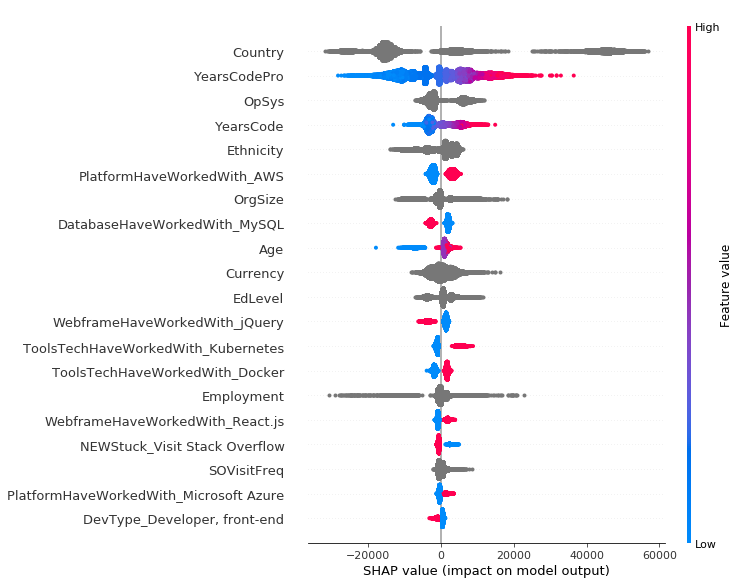

In [60]:
shap.summary_plot(shap_values, X_train, max_display=20)

Теперь закодируем категориальные признаки. Посмотрим есть ли зависимость зарплаты от метки значения.

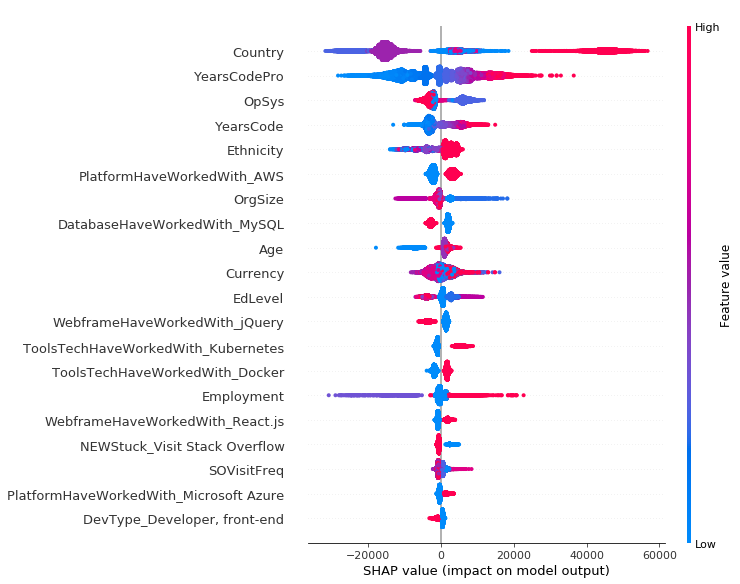

In [61]:
shap.summary_plot(shap_values, X_train_label, max_display=20)

Да, действительно, от значения категориального признака зависит зарплата. Например, для признака `Country` значение `United States of America` закодировано значением 5 (наибольшим), и видим, что высокие значения признака вносят положительный вклад в предсказание зарплаты.

А вот с признаком `OpSys` дело обстоит очень интересно: значения `Windows` и `Windows Subsystem for Linux (WSL)` закодированы соответственно метками 5 и 6, а `Linux-based` и `MacOS` 1 и 2. Видим, ОС Windows вносит отрицательный вклад, в то время как Linux и Mac -- положительный.

Для удобства анализа выведем на экран метку и значение для каждого категориального признака:

In [62]:
for feature_name, values in categorical_names.items():
    print(feature_name)
    for i, val in enumerate(values):
        print(i, '\t', val)
    print()

MainBranch
0 	 I am a developer by profession
1 	 I am not primarily a developer, but I write code sometimes as part of my work

Employment
0 	 Employed full-time
1 	 Employed part-time
2 	 I prefer not to say
3 	 Independent contractor, freelancer, or self-employed
4 	 N/A
5 	 Retired

Country
0 	 Canada
1 	 Germany
2 	 India
3 	 Other
4 	 United Kingdom of Great Britain and Northern Ireland
5 	 United States of America

EdLevel
0 	 Bachelor’s degree (B.A., B.S., B.Eng., etc.)
1 	 Master’s degree (M.A., M.S., M.Eng., MBA, etc.)
2 	 Other
3 	 Other doctoral degree (Ph.D., Ed.D., etc.)
4 	 Secondary school (e.g. American high school, German Realschule or Gymnasium, etc.)
5 	 Some college/university study without earning a degree

OrgSize
0 	 1,000 to 4,999 employees
1 	 10,000 or more employees
2 	 100 to 499 employees
3 	 2 to 9 employees
4 	 20 to 99 employees
5 	 Other

Currency
0 	 CAD	Canadian dollar
1 	 EUR European Euro
2 	 GBP	Pound sterling
3 	 INR	Indian rupee
4 	 Other
5 	 US

### Catboost

Так как наилучшее качество показал Catboost, оценим важность признаков и с его помощью. Стоит отметить, что он может оценить важность признаков, используя SHAP values, но мы так делать не будем.

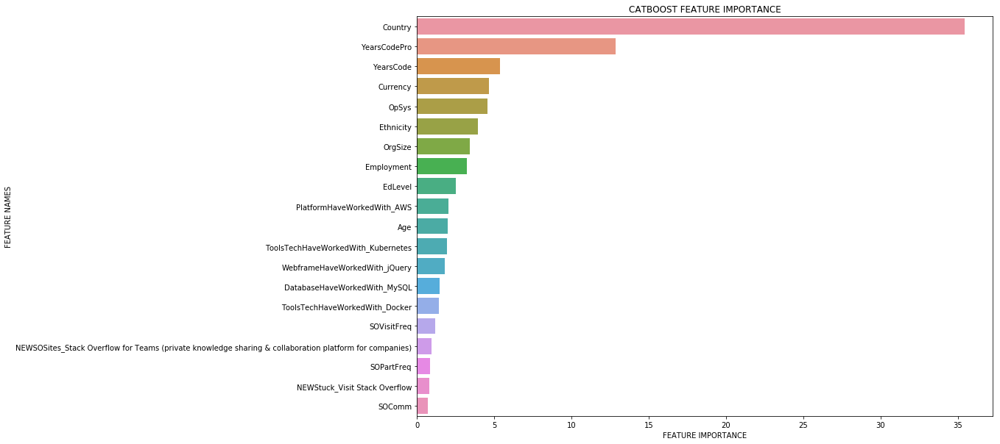

In [63]:
def plot_feature_importance(importance, names, max_display=20):
    
    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)
    
    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)
    
    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)
    
    #Define size of bar plot
    plt.figure(figsize=(14,10))
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'][:max_display], y=fi_df['feature_names'][:max_display])
    #Add chart labels
    plt.title('CATBOOST FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')
    
    
plot_feature_importance(model.get_feature_importance(), feature_names, max_display=20)

Топ-20 признаков для CatBoost и SHAP почти совпадает, но порядок немного другой, хотя в обоих случаях `Country` выделен как самый важный признак.

## Важность признаков по классам

Так как решается задача регрессии, а требуется анализ по классам, преобразуем целевую переменную следующим образом:

пусть объекты, с зарплатой не более значения медианы на обучающей выборке, принадлежат классу 0, а остальные объекты -- классу 1.

In [64]:
MEDIAN = np.median(y_train)

def get_categorial_y(y):
    y = np.array(y)
    y[np.where(y <= MEDIAN)] = 0
    y[np.where(y > MEDIAN)] = 1
    y = y.ravel()
    return y

y_train_cat = get_categorial_y(y_train)
y_val_cat = get_categorial_y(y_val)
y_test_cat = get_categorial_y(y_test)

По этому критерию поделим значения shap values на значения для класса 0 и для класса 1.

In [65]:
rows_class_0 = np.where(y_train_cat==0)[0]
rows_class_1 = np.where(y_train_cat==1)[0]

X_train_label_class_0 = X_train_label.iloc[rows_class_0, :]
X_train_label_class_1 = X_train_label.iloc[rows_class_1, :]

shap_values_class_0 = shap_values[rows_class_0]
shap_values_class_1 = shap_values[rows_class_1]

Выведем на экран важность признаков для каждого класса.

### Важность признаков для класса 0 (зарплата <= медианы)

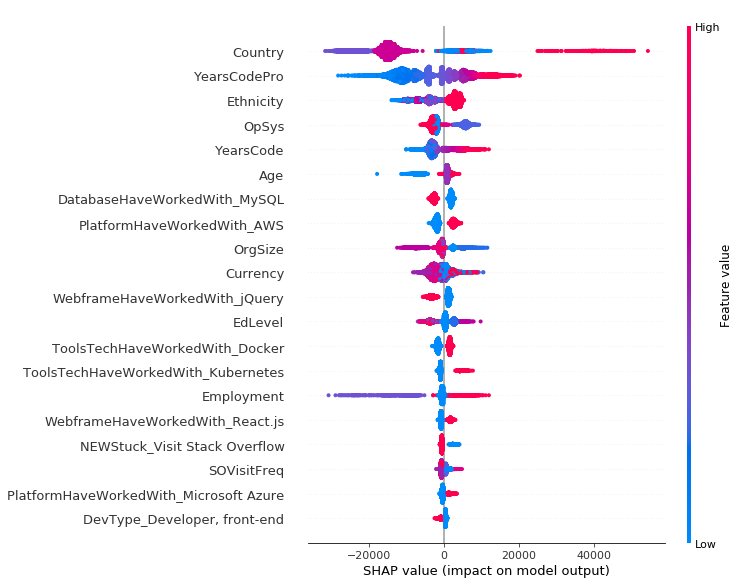

In [66]:
shap.summary_plot(shap_values_class_0, X_train_label_class_0, feature_names, max_display=20)

### Важность признаков для класса 0 (зарплата > медианы)

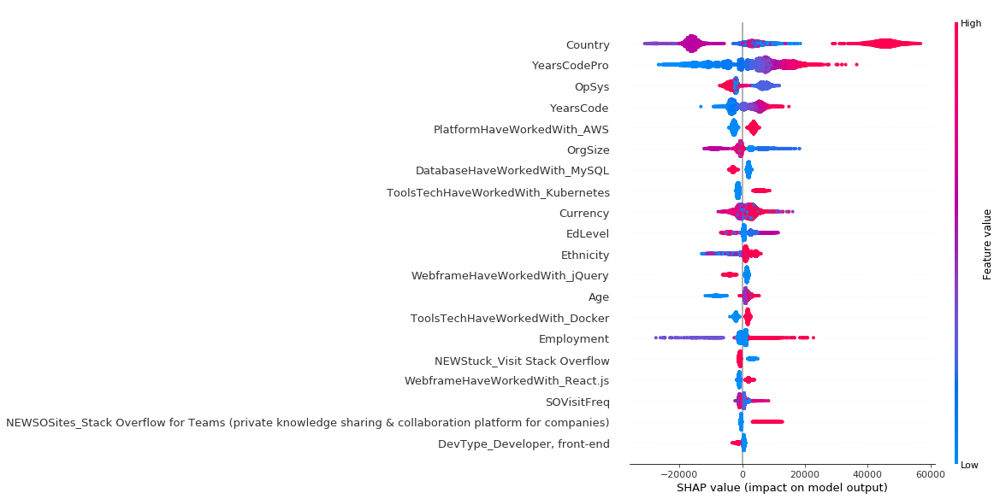

In [67]:
shap.summary_plot(shap_values_class_1, X_train_label_class_1, feature_names, max_display=20)

SHAP values для разных классов похожи, хотя порядок важности признаков немного отличается. Интуитивно казалось, что картинки должны быть зеркальным отражением друг друга, хотя на практике вышло иначе. 

Важность признаков внутри класса и между классами существенно не меняется.

### Разбор примеров

Рассмотрим примеры, где модель предсказывает верно и где ошибается. Так как решается задача регрессии, то в качестве верного предсказания будем брать не точное совпадение предсказания, а предсказания с небольшой абсолютной ошибкой. В качестве неверного предсказания будем брать предсказание с большой абсолютной ошибкой.

In [68]:
small_but_big_predict = 3545
big_but_small_predict = 6217
big_and_big_predict = 8088
small_and_small_predict = 8140

examples  = [small_but_big_predict, big_but_small_predict, big_and_big_predict, small_and_small_predict]

In [69]:
def get_predict(model, X_test, y_test):
    y_pred = model.predict(X_test)
    y_test_ = y_test.values.reshape((y_test.shape[0], ))
    return y_test_, y_pred

Выберем 4 примера из тестовой выборки и проанализируем их

## CatBoost

In [70]:
y_test_, y_pred = get_predict(model, X_test, y_test)

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test.iloc[examples,:])

In [71]:
i = 0
example = examples[i]
print('Модель ошиблась: большое предсказание при маленьком значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test.iloc[pid], feature_names=feature_names)

Модель ошиблась: большое предсказание при маленьком значении
Test ID:  3545
Предсказание: 165046
Реальное значение: 48000


In [72]:
i = 1
example = examples[i]
print('Модель ошиблась: маленькое предсказание при большом значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test.iloc[pid], feature_names=feature_names)

Модель ошиблась: маленькое предсказание при большом значении
Test ID:  6217
Предсказание: 30214
Реальное значение: 233496


In [73]:
i = 2
example = examples[i]
print('Модель верно ответила: большое предсказание при большом значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test.iloc[pid], feature_names=feature_names)

Модель верно ответила: большое предсказание при большом значении
Test ID:  8088
Предсказание: 163904
Реальное значение: 165000


In [74]:
i = 3
example = examples[i]
print('Модель верно ответила: маленькое предсказание при маленьком значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test.iloc[pid], feature_names=feature_names)

Модель верно ответила: маленькое предсказание при маленьком значении
Test ID:  8140
Предсказание: 16770
Реальное значение: 13620


## Линейная модель

In [75]:
X_train_ohe = pd.read_csv('./data/processed/X_train_ohe.csv', na_filter=False)
X_val_ohe = pd.read_csv('./data/processed/X_val_ohe.csv', na_filter=False)
X_test_ohe = pd.read_csv('./data/processed/X_test_ohe.csv', na_filter=False)

model = lasso_model

In [76]:
feature_names_ohe = X_train_ohe.columns

In [77]:
y_test_, y_pred = get_predict(model, X_test_ohe, y_test)

explainer = shap.Explainer(model, X_train_ohe, feature_names=feature_names_ohe)
shap_values = explainer.shap_values(X_test_ohe.iloc[examples,:])

In [78]:
i = 0
example = examples[i]
print('Модель ошиблась: большое предсказание при маленьком значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test_ohe.iloc[pid], feature_names=feature_names_ohe)

Модель ошиблась: большое предсказание при маленьком значении
Test ID:  3545
Предсказание: 710704
Реальное значение: 48000


In [79]:
i = 1
example = examples[i]
print('Модель ошиблась: маленькое предсказание при большом значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test_ohe.iloc[pid], feature_names=feature_names_ohe)

Модель ошиблась: маленькое предсказание при большом значении
Test ID:  6217
Предсказание: 105064
Реальное значение: 233496


In [80]:
i = 2
example = examples[i]
print('Модель верно ответила: большое предсказание при большом значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test_ohe.iloc[pid], feature_names=feature_names_ohe)

Модель верно ответила: большое предсказание при большом значении
Test ID:  8088
Предсказание: 410454
Реальное значение: 165000


In [81]:
i = 3
example = examples[i]
print('Модель верно ответила: маленькое предсказание при маленьком значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[example])
print("Реальное значение: %.0f" % y_test_[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[rip], X_test_ohe.iloc[pid], feature_names=feature_names_ohe)

Модель верно ответила: маленькое предсказание при маленьком значении
Test ID:  8140
Предсказание: 134826
Реальное значение: 13620


# Нейронная сеть

In [84]:
labels = pd.concat([y_train, y_test])
le= LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [85]:
les={} 
for feature in categorical_features_indices:
    le = LabelEncoder() 
    le.fit(dataset[:, feature])
    dataset[:, feature] = le.transform(dataset[:, feature])
    #categorical_names[feature] = le.classes_ 
    les[feature] = le

dataset = dataset.astype(float)

In [86]:
train = dataset[:X_train.shape[0], :]
test = dataset[X_train.shape[0]:, :]
labels_train = labels[:X_train.shape[0]]
labels_test = labels[X_train.shape[0]:]

In [87]:
predict_fn = lambda x: model_nn.predict(np.asarray(encoder.transform(x)).astype('float32')).astype(float)

In [88]:
y_pred = predict_fn(test[examples])

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [89]:
explainer = shap.KernelExplainer(predict_fn, train[:500], feature_names=feature_names,
                                                   categorical_features=categorical_features_indices,
                                                   categorical_names=categorical_names)

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
Using 500 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [90]:
shap_values = explainer.shap_values(test[examples], nsamples=500, feature_names=feature_names,
                                                   categorical_features=categorical_features_indices,
                                                   categorical_names=categorical_names);

  0%|          | 0/4 [00:00<?, ?it/s]

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To

In [91]:
i = 0
example = examples[i]
print('NN модель ошиблась: большое предсказание при маленьком значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[i])
print("Реальное значение: %.0f" % labels_test[example])

shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0][i], test[example], feature_names=feature_names)

NN модель ошиблась: большое предсказание при маленьком значении
Test ID:  3545
Предсказание: 183118
Реальное значение: 3045


In [92]:
i = 1
example = examples[i]
print('NN модель ошиблась: маленькое предсказание при большом значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[i])
print("Реальное значение: %.0f" % labels_test[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0][i], test[example], feature_names=feature_names)

NN модель ошиблась: маленькое предсказание при большом значении
Test ID:  6217
Предсказание: 29952
Реальное значение: 6433


In [93]:
i = 2
example = examples[i]
print('NN модель верно ответила: большое предсказание при большом значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[i])
print("Реальное значение: %.0f" % labels_test[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0][i], test[example], feature_names=feature_names)

NN модель верно ответила: большое предсказание при большом значении
Test ID:  8088
Предсказание: 162314
Реальное значение: 6146


In [94]:
i = 3
example = examples[i]
print('NN модель верно ответила: маленькое предсказание при маленьком значении')
print('Test ID: ', example)
print("Предсказание: %.0f" % y_pred[i])
print("Реальное значение: %.0f" % labels_test[example])

rip, pid = (i, example)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0][i], test[example], feature_names=feature_names)

NN модель верно ответила: маленькое предсказание при маленьком значении
Test ID:  8140
Предсказание: 14080
Реальное значение: 624


# Применение LIME

In [50]:
import lime
import lime.lime_tabular
from lime import submodular_pick
import sklearn
from sklearn.preprocessing import LabelEncoder

## Нейронная сеть

In [96]:
model = model_nn

In [97]:
labels = pd.concat([y_train, y_test])
le= LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [98]:
les={} 
for feature in categorical_features_indices:
    le = LabelEncoder() 
    le.fit(dataset[:, feature])
    dataset[:, feature] = le.transform(dataset[:, feature])
    #categorical_names[feature] = le.classes_ 
    les[feature] = le

dataset = dataset.astype(float)

In [99]:
train = dataset[:X_train.shape[0], :]
test = dataset[X_train.shape[0]:, :]
labels_train = labels[:X_train.shape[0]]
labels_test = labels[X_train.shape[0]:]

In [100]:
explainer = lime.lime_tabular.LimeTabularExplainer(train,mode='regression',feature_names=feature_names,
                                                   categorical_features=categorical_features_indices,
                                                   categorical_names=categorical_names,
                                                   class_names=['ConvertedCompYearly'])

In [101]:
predict_fn = lambda x: model.predict(np.asarray(encoder.transform(x)).astype('float32')).astype(float)

In [102]:
n_explanations = 20

In [103]:
diff_array = pd.DataFrame() 
diff_array['real'] = pd.concat([y_test])
diff_array['predict'] = model.predict(encoded_test)
diff_array['diff'] = diff_array['real'] - diff_array['predict']


In [104]:
small_but_big_predict =3545    
big_but_small_predict =6217
big_and_big_predict = 8088    
small_and_small_predict=8140 

In [105]:
exp = explainer.explain_instance(test[big_and_big_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[big_and_big_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[big_and_big_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [165000.]
Predicted  ConvertedCompYearly= [162313.73]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use

In [106]:
exp = explainer.explain_instance(test[small_and_small_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[small_and_small_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[small_and_small_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [13620.]
Predicted  ConvertedCompYearly= [14080.496]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use

In [107]:
exp = explainer.explain_instance(test[small_but_big_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[small_but_big_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[small_but_big_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [48000.]
Predicted  ConvertedCompYearly= [183118.48]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use

In [108]:
exp = explainer.explain_instance(test[big_but_small_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[big_but_small_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[big_but_small_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [233496.]
Predicted  ConvertedCompYearly= [29951.717]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use

## CatBoost

In [134]:
X_train = pd.read_csv('./data/processed/X_train.csv', na_filter=False)
X_val = pd.read_csv('./data/processed/X_val.csv', na_filter=False)
X_test = pd.read_csv('./data/processed/X_test.csv', na_filter=False)

y_train = pd.read_csv('./data/processed/y_train.csv', na_filter=False)
y_val = pd.read_csv('./data/processed/y_val.csv', na_filter=False)
y_test = pd.read_csv('./data/processed/y_test.csv', na_filter=False)

In [135]:
cat_features = ['MainBranch', 'Employment', 'Country', 'EdLevel', 'OrgSize', 'Currency',
                'OpSys', 'SOVisitFreq', 'SOAccount', 'SOPartFreq', 'SOComm', 'NEWOtherComms',
                'Gender', 'Ethnicity', 'SurveyLength', 'SurveyEase']

In [136]:
model = CatBoostRegressor()
model.load_model('./models/catboost.cbm')

In [137]:
dataset = pd.concat([X_train, X_test])

In [138]:
feature_names = X_train.columns
numeric_features = ['YearsCode', 'YearsCodePro', 'Age', 'Age1stCode']
categorical_features = list(filter(lambda col: col not in numeric_features, X_train.columns))
categorical_features_indices = list(filter(lambda idx: idx not in [4, 5], list(range(51))))

In [139]:
# split data on features and labels encoded with integers
labels = pd.concat([y_train, y_test])
le= LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
#class_names = le.classes_
dataset = dataset[feature_names].values

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [140]:
categorical_names = {} 
les={} 
for feature in categorical_features_indices:
    le = LabelEncoder() 
    le.fit(dataset[:, feature])
    dataset[:, feature] = le.transform(dataset[:, feature])
    categorical_names[feature] = le.classes_ 
    les[feature] = le

dataset = dataset.astype(float)

In [141]:
train = dataset[:X_train.shape[0], :]
test = dataset[X_train.shape[0]:, :]
labels_train = labels[:X_train.shape[0]]
labels_test = labels[X_train.shape[0]:]

In [142]:
def restore_line(X):
    X = X.astype(object)
    for feature in categorical_features_indices: 
        le = les[feature]
        X[:,feature] = le.inverse_transform(X[:,feature].astype(int))

    d_res = pd.DataFrame(X, columns=[x for x in X_train.columns]) 
      
    return(d_res) 

In [143]:
predict_fn = lambda x: model.predict(restore_line(x)).astype(float)

In [144]:
explainer = lime.lime_tabular.LimeTabularExplainer(train,mode='regression',feature_names=feature_names,
                                                   categorical_features=categorical_features_indices,
                                                   categorical_names=categorical_names,
                                                   class_names=['ConvertedCompYearly'])

In [145]:
n_explanations = 20

In [146]:
diff_array = pd.DataFrame() 
diff_array['real'] = pd.concat([y_test])
diff_array['predict'] = model.predict(pd.concat([X_test]))
diff_array['diff'] = diff_array['real'] - diff_array['predict']
diff_array['abs_diff'] = abs(diff_array['real'] - diff_array['predict'])

small_but_big_predict =3545    
big_but_small_predict =6217
big_and_big_predict = 8088    
small_and_small_predict=8140 

In [147]:
exp = explainer.explain_instance(test[big_and_big_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[big_and_big_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[big_and_big_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [165000.]
Predicted  ConvertedCompYearly= [163903.51257732]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [148]:
exp = explainer.explain_instance(test[small_and_small_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[small_and_small_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[small_and_small_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [13620.]
Predicted  ConvertedCompYearly= [16769.57816613]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [149]:


exp = explainer.explain_instance(test[small_but_big_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[small_but_big_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[small_but_big_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)



Real       ConvertedCompYearly= [48000.]
Predicted  ConvertedCompYearly= [165046.11860458]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [150]:
exp = explainer.explain_instance(test[big_but_small_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[big_but_small_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[big_but_small_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [233496.]
Predicted  ConvertedCompYearly= [30213.8199279]


`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


## Линейная модель

In [12]:
X_train = pd.read_csv('./data/processed/X_train.csv', na_filter=False)
X_val = pd.read_csv('./data/processed/X_val.csv', na_filter=False)
X_test = pd.read_csv('./data/processed/X_test.csv', na_filter=False)

y_train = pd.read_csv('./data/processed/y_train.csv', na_filter=False)
y_val = pd.read_csv('./data/processed/y_val.csv', na_filter=False)
y_test = pd.read_csv('./data/processed/y_test.csv', na_filter=False)

In [13]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
feature_names = X_train.columns
dataset = pd.concat([X_train, X_test])
numeric_features = ['YearsCode', 'YearsCodePro', 'Age', 'Age1stCode']
categorical_features = list(filter(lambda col: col not in numeric_features, X_train.columns))
categorical_features_indices = list(filter(lambda idx: idx not in [4, 5], list(range(51))))

dataset = dataset[feature_names].values
val_dataset = X_val.copy()
val_dataset = val_dataset[feature_names].values
train_dataset = X_train.copy()
train_dataset = train_dataset[feature_names].values
test_dataset = X_test.copy()
test_dataset = test_dataset[feature_names].values
categorical_names = {} 
les={} 
for feature in categorical_features_indices:
    le = LabelEncoder() 
    le.fit(dataset[:, feature])
    dataset[:, feature] = le.transform(dataset[:, feature])
    val_dataset[:, feature] = le.transform(val_dataset[:, feature])
    train_dataset[:, feature] = le.transform(train_dataset[:, feature])
    test_dataset[:, feature] = le.transform(test_dataset[:, feature])
    categorical_names[feature] = le.classes_ 
    les[feature] = le

dataset = dataset.astype('float32') 
val_dataset = val_dataset.astype('float32') 
train_dataset = train_dataset.astype('float32') 
test_dataset = test_dataset.astype('float32')
from sklearn.compose import ColumnTransformer 
encoder = ColumnTransformer([("enc", OneHotEncoder(),
                            categorical_features_indices)],
                            remainder = 'passthrough')

encoder.fit(dataset)
 
encoded_dataset = encoder.transform(dataset)
encoded_train = encoder.transform(train_dataset)
encoded_val = encoder.transform(val_dataset)
encoded_test = encoder.transform(test_dataset)

/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/_encoders.py:395: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  check_array(X, dtype=np.int)
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can

In [14]:
lasso_model = Lasso()
lasso_model.fit(encoded_train, y_train)
print(mean_absolute_error(lasso_model.predict(encoded_test), y_test))

22674.67642893914


/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479035067547.28906, tolerance: 5971007215.535019
  positive)


In [15]:
labels = pd.concat([y_train, y_test])
le= LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_

/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/label.py:219: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/label.py:252: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [16]:
les={} 
for feature in categorical_features_indices:
    le = LabelEncoder() 
    le.fit(dataset[:, feature])
    dataset[:, feature] = le.transform(dataset[:, feature])
    #categorical_names[feature] = le.classes_ 
    les[feature] = le

dataset = dataset.astype(float)

In [17]:
train = dataset[:X_train.shape[0], :]
test = dataset[X_train.shape[0]:, :]
labels_train = labels[:X_train.shape[0]]
labels_test = labels[X_train.shape[0]:]

In [23]:
explainer = lime.lime_tabular.LimeTabularExplainer(train,mode='regression',feature_names=feature_names,
                                                   categorical_features=categorical_features_indices,
                                                   categorical_names=categorical_names,
                                                   class_names=['ConvertedCompYearly'])

In [24]:
predict_fn = lambda x: lasso_model.predict(np.asarray(encoder.transform(x)).astype('float32')).astype(float)

In [25]:
n_explanations = 20

In [26]:
diff_array = pd.DataFrame() 
diff_array['real'] = pd.concat([y_test])
diff_array['predict'] = lasso_model.predict(encoded_test)
diff_array['diff'] = diff_array['real'] - diff_array['predict']

In [27]:
small_but_big_predict =3545    
big_but_small_predict =6217
big_and_big_predict = 8088    
small_and_small_predict=8140 

In [28]:
exp = explainer.explain_instance(test[big_and_big_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[big_and_big_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[big_and_big_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [165000.]
Predicted  ConvertedCompYearly= [148262.69856923]


/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/si

In [29]:
exp = explainer.explain_instance(test[small_and_small_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[small_and_small_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[small_and_small_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [13620.]
Predicted  ConvertedCompYearly= [26384.45762773]


/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/si

In [30]:
exp = explainer.explain_instance(test[small_but_big_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[small_but_big_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[small_but_big_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [48000.]
Predicted  ConvertedCompYearly= [199217.03318255]


/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/si

In [31]:
exp = explainer.explain_instance(test[big_but_small_predict], predict_fn, num_features=n_explanations)
print(f"""Real       ConvertedCompYearly= {diff_array.iloc[[big_but_small_predict]]['real'].values}
Predicted  ConvertedCompYearly= {diff_array.iloc[[big_but_small_predict]]['predict'].values}""")
exp.show_in_notebook(show_all=False)

Real       ConvertedCompYearly= [233496.]
Predicted  ConvertedCompYearly= [43925.68832174]


/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:56: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
/home/tgorlenko/anaconda3/lib/python3.7/si

# Выводы

1. Гипотезы, высказанные в первой части, подтвердились.
2. Ожидаемым результатом оказалось, что зарплата сильно зависит от страны. Но неожиданным оказалось, что вклад будет настолько сильным.
3. Объяснения примеров с помощью SHAP и LIME похожи, но не идентичны. Например, LIME использовал признак `Gender`, в то время как в SHAP он даже не вошел в топ-20.
4. Изначально решалась задача регрессии, но в заданиях необходимо было рассматривать примеры из разных классов. Пришлось искусственно разделить целевую переменную на классы по порогу. Оптимальным вариантом показалось выбрать медиану, а не среднее арифметическое.